# BBC News Classification Project: Machine Learning and Sequential Model Approach

# Data Acquisition
We use dataset from Kaggle, but the owner of the dataset does not specify the details about the License, so we further check if the BBC NEWS dataset has been published and need to be cited. We find:
The BBC NEWS dataset has ever been used for Kaggle competition and manually examine if the dataset is the same dataset. The result is that the labels and text content are the same.
We find the original the original BBC News Archive on Kaggle, yet the dataset has not been split into category and text content. It specified “ALL RIGHTS, INCLUDING COPYRIGHT, IN THE CONTENT OF THJE ORIOGINAL ARTICLES ARE OWNED BY BBC.”
We actually download the dataset from BBC News Classification on Kaggle because the dataset has been split into categories and text content, which is fit our learning object.
Therefore, we decide to cite these three resources and use the dataset from bbc-text article on Kaggle.

Download dataset from Kaggle:
bbc-text:
https://www.kaggle.com/datasets/prajaktawaikar/bbctext/download?datasetVersionNumber=1

# Import necessary library

In [ ]:
# Environment setting
import sys
import os
import numpy as np
import pandas as pd

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
from sklearn.manifold import TSNE
from sklearn.metrics import confusion_matrix

# Text cleaning
import re

# Linguistic analysis
# NER
import spacy
nlp = spacy.load("en_core_web_sm")
from collections import Counter
# POS TAGGING
import nltk
from collections import Counter
# Readibility
import textstat
# Text Fingerprinting
from sklearn.feature_extraction.text import CountVectorizer
# Sentiment analysis
from textblob import TextBlob
# Emotion detection
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
from matplotlib.cm import get_cmap
from collections import defaultdict
from nrclex import NRCLex
# Temporal Recognition
import datefinder

# BERT Tokenization
from sklearn.model_selection import train_test_split
from transformers import BertTokenizer, BertModel
import torch
from sklearn.preprocessing import StandardScaler

# LabelEncoder
from sklearn.preprocessing import LabelEncoder
# One-hot encoding
from sklearn.preprocessing import OneHotEncoder

# UMAP dimension reduction
import umap.umap_ as umap
from sklearn.preprocessing import StandardScaler

# Machine Learning function
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV, KFold, cross_val_score, learning_curve
from sklearn.metrics import classification_report, accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.multiclass import OneVsRestClassifier #test
from sklearn.naive_bayes import MultinomialNB

# Sequential Model
import keras
import keras_tuner
import keras_tuner as kt
import tensorflow as tf
tf.random.set_seed(42)
np.random.seed(42)
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.optimizers import SGD, RMSprop, Adam, Adamax, Nadam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau #test

# Split dataset and Training
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import load_model

# Tensor Board
from tensorflow.keras.callbacks import TensorBoard
%load_ext tensorboard

# Random Search, Hyperband optimization, Bayesian optimisation
from keras_tuner import RandomSearch
from kerastuner.tuners import Hyperband
from kerastuner.tuners import BayesianOptimization

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
<ipython-input-8-e1319ab34871>:92: DeprecationWarning: `import kerastuner` is deprecated, please use `import keras_tuner`.
  from kerastuner.tuners import Hyperband


# Google drive and Colab setting

In [ ]:
if 'google.colab' in sys.modules:
    from google.colab import drive
    drive.mount('/content/drive')
    os.chdir('/content/drive/My Drive/Colab Notebooks')
    os.listdir()

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Exploratory Data Analysis (EDA)

In [ ]:
# define file path
file_path = '/content/drive/My Drive/Colab Notebooks/bbc_text.csv'

# load csv file
df = pd.read_csv(file_path)

# use .shape to acquire rows and columns
rows, columns = df.shape

# display
print(df.info())
print(df.head(20))
print(df.shape)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2225 entries, 0 to 2224
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   category  2225 non-null   object
 1   text      2225 non-null   object
dtypes: object(2)
memory usage: 34.9+ KB
None
         category                                               text
0            tech  tv future in the hands of viewers with home th...
1        business  worldcom boss  left books alone  former worldc...
2           sport  tigers wary of farrell  gamble  leicester say ...
3           sport  yeading face newcastle in fa cup premiership s...
4   entertainment  ocean s twelve raids box office ocean s twelve...
5        politics  howard hits back at mongrel jibe michael howar...
6        politics  blair prepares to name poll date tony blair is...
7           sport  henman hopes ended in dubai third seed tim hen...
8           sport  wilkinson fit to face edinburgh england captai...
9   en

In [ ]:
df['text'][42]

'house prices show slight increase prices of homes in the uk rose a seasonally adjusted 0.5% in february  says the nationwide building society.  the figure means the annual rate of increase in the uk is down to 10.2%  the lowest rate since june 2001. the annual rate has halved since august last year  as interest rises have cooled the housing market. at the same time  the number of mortgage approvals fell in january to a near 10-year low  official bank of england figures have shown.  nationwide said that in january house prices went up by 0.4% on the month and by 12.6% on a year earlier.  we are not seeing the market collapsing in the way some had feared   said nationwide economist alex bannister. there have been a number of warnings that the uk housing market may be heading for a downturn after four years of strong growth to 2004. in november  barclays  which owns former building society the woolwich  forecast an 8% fall in property prices in 2005  followed by further declines in 2006 

In [ ]:
df.describe()

,category,text
count,2225,2225
unique,5,2126
top,sport,blind student hears in colour a blind studen...
freq,511,2


In [ ]:
# count and print the number of each category
category_counts = df['category'].value_counts()

print(category_counts)

category
sport            511
business         510
politics         417
tech             401
entertainment    386
Name: count, dtype: int64


# Examine null value in the dataset

In [ ]:
print(df.isnull().sum())

category    0
text        0
dtype: int64


# Examine duplications

Number of duplicate rows: 198
Number of duplicate columns after transpose: 0
Duplicate counts per category:
category
tech             108
entertainment     34
politics          28
business          14
sport             14
Name: count, dtype: int64
Duplicate rows sorted by 'text' column:
     category                                               text
1755     tech  2d metal slug offers retro fun like some drill...
137      tech  2d metal slug offers retro fun like some drill...
930      tech  apple attacked over sources row civil libertie...
718      tech  apple attacked over sources row civil libertie...
1060     tech  apple ipod family expands market apple has exp...
...       ...                                                ...
1774     tech  warning over tsunami aid website net users are...
956      tech  web radio takes spanish rap global spin the ra...
109      tech  web radio takes spanish rap global spin the ra...
2016     tech  what high-definition will do to dvds first it .

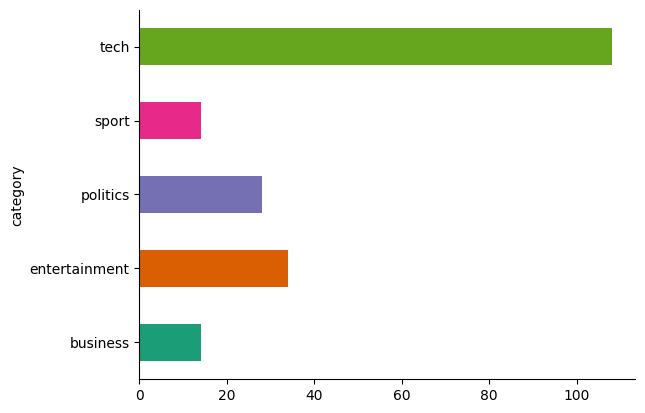

In [ ]:
# check duplicated rows
duplicate_rows = df[df.duplicated(keep=False)]
print(f"Number of duplicate rows: {duplicate_rows.shape[0]}")

# check duplicated columns
print(f"Number of duplicate columns after transpose: {df.T.duplicated().sum()}")

# display the duplicated quatities in each categories
print("Duplicate counts per category:")
print(duplicate_rows['category'].value_counts())

# display the duplicated rows and listed in sorted texts
print("Duplicate rows sorted by 'text' column:")
print(duplicate_rows.sort_values(by='text'))

# plot duplicated rows for each category
duplicate_rows.groupby('category').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

# Dara Preprocessing

# Remove duplicate rows

In [ ]:
# acquire rows in the original dataframe
original_rows = df.shape[0]

# delete duplicated rows
df = df.drop_duplicates()

# acquire new rows
new_rows = df.shape[0]

# calculate deleted rows
dropped_rows = original_rows - new_rows

print(f"Number of rows dropped: {dropped_rows}")

Number of rows dropped: 99


# Examine percentage of each category after remove duplication

Counts for each category:
category
sport            504
business         503
politics         403
entertainment    369
tech             347
Name: count, dtype: int64

Total number of rows: 2126

NUMBER OF SAMPLES IN EACH CATEGORY: 



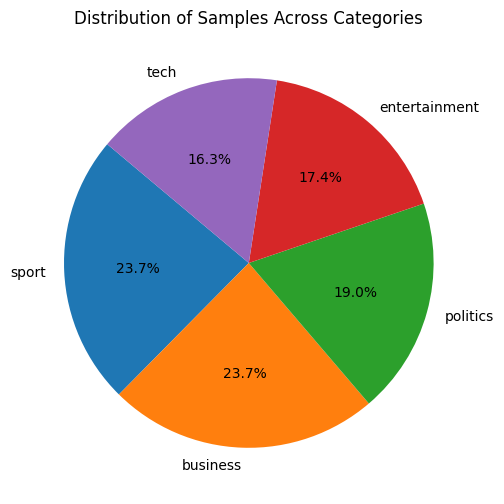

In [ ]:
# category counts
category_counts = df['category'].value_counts()

# print out the counts for each category
print("Counts for each category:")
print(category_counts)

# display all rows
total_rows = df.shape[0]
print(f"\nTotal number of rows: {total_rows}")

# visualize the total number of samples in each category in a pie chart
print('\nNUMBER OF SAMPLES IN EACH CATEGORY: \n')
plt.figure(figsize=(6, 6))
plt.pie(category_counts, labels=category_counts.index, autopct='%1.1f%%', startangle=140)
plt.title('Distribution of Samples Across Categories')
plt.show()

# Examine word count

In [ ]:
# word counts for each text
word_counts = df['text'].str.split().apply(len)

# get text with more than 1000 words
long_texts = word_counts[word_counts > 1000]

# count the number of texts with more than 1000 words
num_long_texts = long_texts.shape[0]
print(f"Number of texts with more than 1000 words: {num_long_texts}")

# count the number of texts with more than 1000 words in each category
long_texts_by_category = df.loc[word_counts > 1000, 'category'].value_counts()
print("\nNumber of long texts (>1000 words) per category:")
print(long_texts_by_category)

# calculate statistics for text word count
text_stats = word_counts.describe()
print("\nStatistics of word counts:")
print(text_stats)

Number of texts with more than 1000 words: 25

Number of long texts (>1000 words) per category:
category
tech             10
entertainment     6
sport             5
politics          4
Name: count, dtype: int64

Statistics of word counts:
count    2126.000000
mean      390.452023
std       245.118037
min        90.000000
25%       249.000000
50%       336.500000
75%       479.000000
max      4492.000000
Name: text, dtype: float64


# Text length distribution

<ipython-input-19-73ee3fea4d5c>:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(word_counts, bins=30, kde=True)


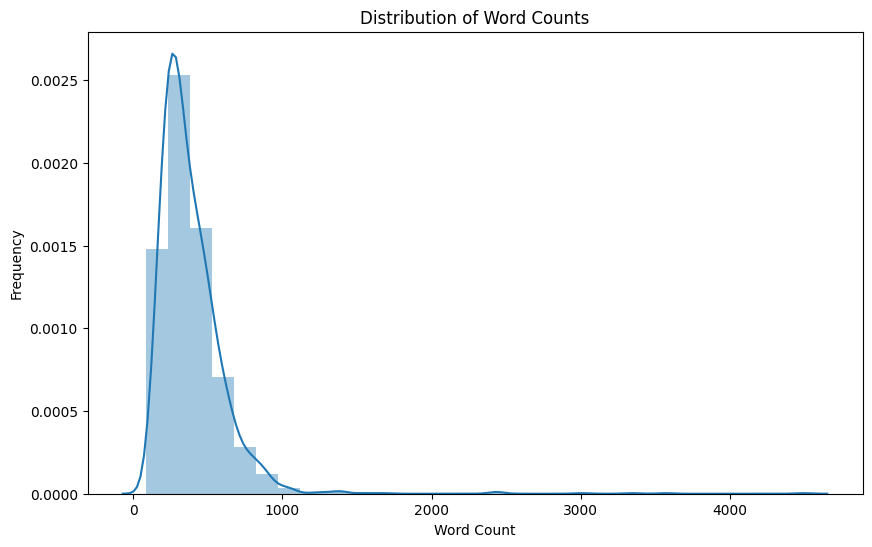

In [ ]:
# initialize distribution plot
plt.figure(figsize=(10, 6))
sns.distplot(word_counts, bins=30, kde=True)

# plot and display
plt.title('Distribution of Word Counts')
plt.xlabel('Word Count')
plt.ylabel('Frequency')
plt.show()

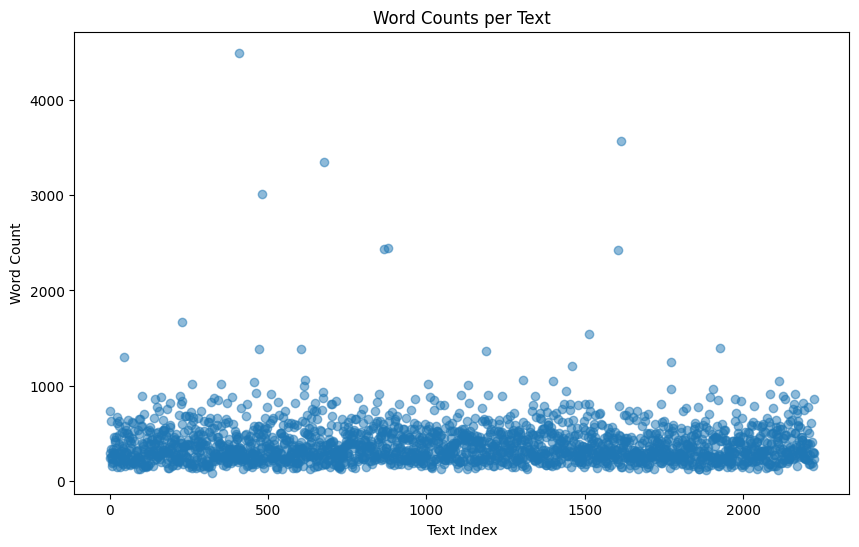

In [ ]:
# initialize scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(df.index, word_counts, alpha=0.5)

# plot and display
plt.title('Word Counts per Text')
plt.xlabel('Text Index')
plt.ylabel('Word Count')
plt.show()

# Sentences length in text

<ipython-input-21-73dbf6f3b602>:15: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  sns.violinplot(data=[sent_lengths[label] for label in df['category'].unique()],
<ipython-input-21-73dbf6f3b602>:25: UserWarning: FixedFormatter should only be used together with FixedLocator
  plt.gca().set_yticklabels(df['category'].unique())


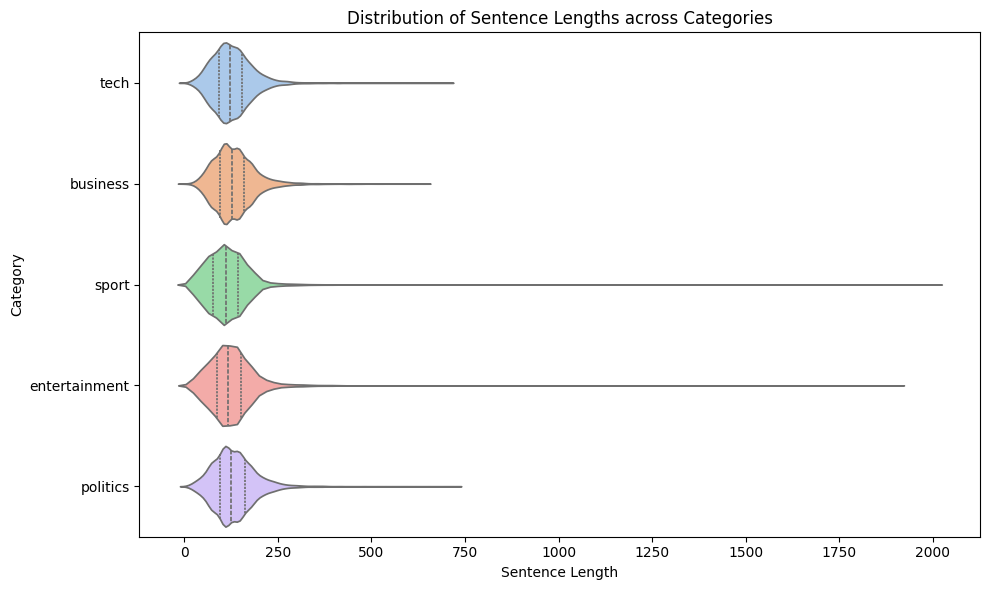

In [ ]:
# iterate through each unique category in the dataframe df_re
sent_lengths = {
    label: [
        len(sent)
        for text in df[df['category'] == label]['text']
        for sent in nltk.sent_tokenize(text)
    ]
    for label in df['category'].unique()
}

# initialize violin plot
plt.figure(figsize=(10, 6))

# plot violin plots for each category
sns.violinplot(data=[sent_lengths[label] for label in df['category'].unique()],
               orient='h',
               scale='width',
               inner='quartile',
               palette='pastel')

# add labels and legend
plt.xlabel('Sentence Length')
plt.ylabel('Category')
plt.title('Distribution of Sentence Lengths across Categories')
plt.gca().set_yticklabels(df['category'].unique())

plt.tight_layout()
plt.show()

# Text Cleaning

In [ ]:
# denoising function
def remove_noise(text):
    # remove html tags
    text = re.sub(r'<.*?>', '', text)

    # remove URL
    text = re.sub(r'https?://\S+|www\.\S+', '', text)

    # remove mail box
    text = re.sub(r'\S+@\S+', '', text)

    # remove newlines and extra whitespace characters
    text = re.sub(r'\n', ' ', text)
    text = re.sub(r'\s+', ' ', text)

    return text.strip()

# apply denoising function to the 'text' column of the dataframe
df['text'] = df['text'].apply(remove_noise)

# save the denoised data frame as a new data frame
df_re = df.copy()

# display denoised data
print(df_re.head(20))

# check shape
print(df_re.shape)
print(df_re.columns)

# count the number of words in each text
word_counts = df_re['text'].str.split().apply(len)

# calculate statistics for text word count
text_stats = word_counts.describe()
print("\nStatistics of word counts:")
print(text_stats)

         category                                               text
0            tech  tv future in the hands of viewers with home th...
1        business  worldcom boss left books alone former worldcom...
2           sport  tigers wary of farrell gamble leicester say th...
3           sport  yeading face newcastle in fa cup premiership s...
4   entertainment  ocean s twelve raids box office ocean s twelve...
5        politics  howard hits back at mongrel jibe michael howar...
6        politics  blair prepares to name poll date tony blair is...
7           sport  henman hopes ended in dubai third seed tim hen...
8           sport  wilkinson fit to face edinburgh england captai...
9   entertainment  last star wars not for children the sixth and ...
10  entertainment  berlin cheers for anti-nazi film a german movi...
11       business  virgin blue shares plummet 20% shares in austr...
12       business  crude oil prices back above $50 cold weather a...
13       politics  hague given up 

# Linguistic analysis

# Grammatical Features

# Part-of-Speech(POS) Tagging

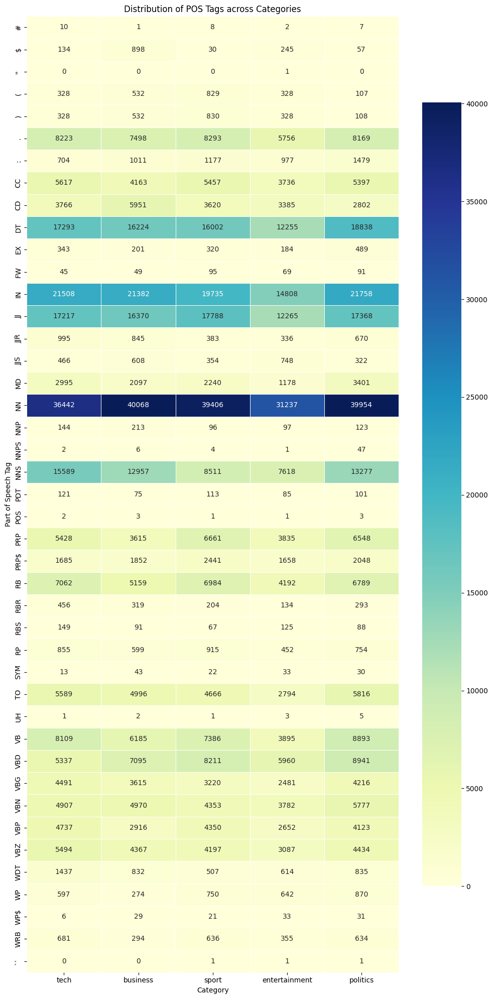

In [ ]:
# punkt for spliting text into words
# averaged_perceptron_tagger' to mark the part-of-speech of words after word segmentation
# nltk.download('punkt')  #nltk
# nltk.download('averaged_perceptron_tagger') # nltk

# initialize the dictionary storing part-of-speech features
pos_features = {label: [] for label in df_re['category'].unique()}

# iterate the text of each category, extract and record part-of-speech tags
for label in df_re['category'].unique():
    texts = df_re[df_re['category'] == label]['text']
    for text in texts:
        words = nltk.word_tokenize(text)
        pos_tags = nltk.pos_tag(words)
        pos_features[label].extend([tag for word, tag in pos_tags])

# statistics for each category
pos_stats = pd.DataFrame({label: pd.Series(Counter(pos_features[label])) for label in df_re['category'].unique()}).fillna(0).astype(int)
pos_stats['total'] = pos_stats.sum(axis=1)

# removes the 'total' column from the pos_stats dataframe
pos_heatmap_data = pos_stats.drop('total', axis=1)

# initialize heatmap
plt.figure(figsize=(10, 20))

# create the heatmap
sns.heatmap(pos_heatmap_data, cmap="YlGnBu", annot=True, fmt='d', cbar_kws={"shrink": .82}, linewidths=.5)

# plot and display
plt.xlabel('Category')
plt.ylabel('Part of Speech Tag')
plt.title('Distribution of POS Tags across Categories')
plt.tight_layout()
plt.show()

# NER

In [ ]:
# initialize the dictionary used to store features
nlp = spacy.load("en_core_web_sm")
ner_features = {label: [] for label in df_re['category'].unique()}

# iterate through each category and extract named entities
for label in df_re['category'].unique():
    texts = df_re[df_re['category'] == label]['text']
    for text in texts:
        doc = nlp(text)
        ents = [ent.label_ for ent in doc.ents]
        ner_features[label].extend(ents)

# calculate and display named entity statistics for each category
ner_stats = pd.DataFrame({label: pd.Series(Counter(ner_features[label])) for label in df_re['category'].unique()}).fillna(0).astype(int)
ner_stats['total'] = ner_stats.sum(axis=1)
print(ner_stats)

/usr/local/lib/python3.10/dist-packages/spacy/util.py:1740: UserWarning: [W111] Jupyter notebook detected: if using `prefer_gpu()` or `require_gpu()`, include it in the same cell right before `spacy.load()` to ensure that the model is loaded on the correct device. More information: http://spacy.io/usage/v3#jupyter-notebook-gpu
  warnings.warn(Warnings.W111)


             tech  business  sport  entertainment  politics  total
CARDINAL     1918      1561   2471           1466      1222   8638
DATE         1756      3723   2896           2274      2084  12733
EVENT           0         8     61             13        41    123
FAC             9        29     39             30        20    127
GPE           982      2356   2081           1096      1383   7898
LANGUAGE       21         1     14             10        11     57
LAW             8        20      5              5         7     45
LOC           174       269     61             81       184    769
MONEY         264      1325     82            478       280   2429
NORP          383       989    971            615      1026   3984
ORDINAL       337       276    979            440       316   2348
ORG          1440      1920    904            776       883   5923
PERCENT       314      1240     21             74       199   1848
PERSON        934      1519   3680           2346      2944  1

## NER Heat Map

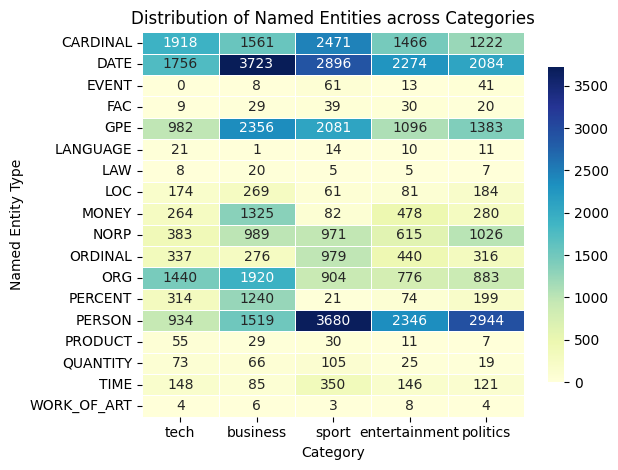

In [ ]:
# removing the 'total' column from the ner_stats dataframe
ner_heatmap_data = ner_stats.drop('total', axis=1)

# generates a heatmap
sns.heatmap(ner_heatmap_data, cmap="YlGnBu", annot=True, fmt='d', cbar_kws={"shrink": .82}, linewidths=.5)

# plot and display
plt.xlabel('Category')
plt.ylabel('Named Entity Type')
plt.title('Distribution of Named Entities across Categories')
plt.tight_layout()
plt.show()

# Pragmatic Features

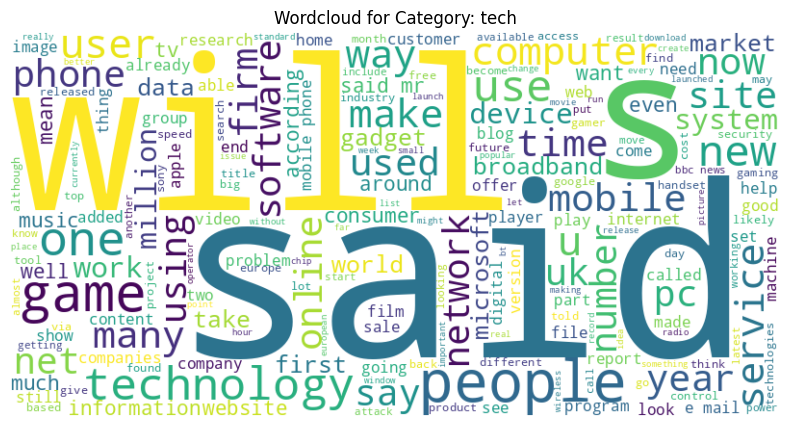

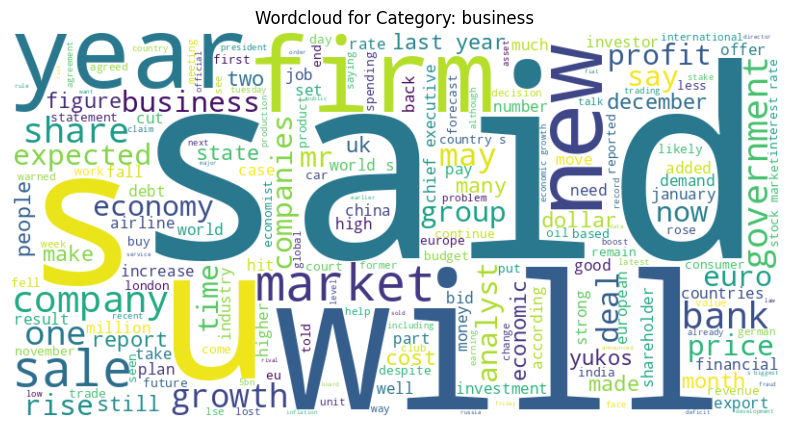

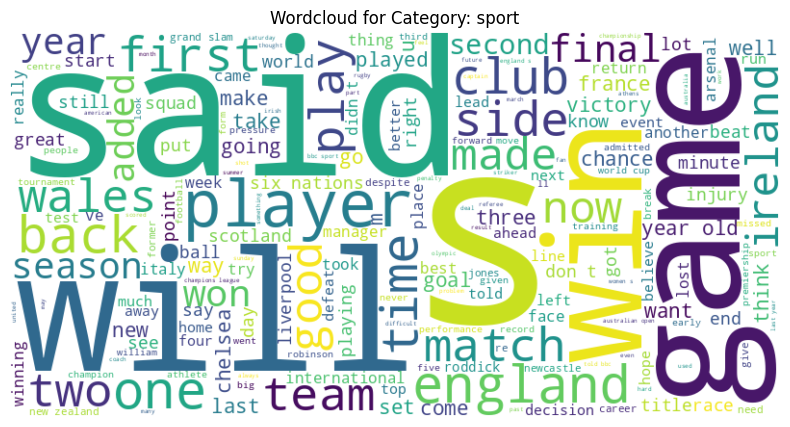

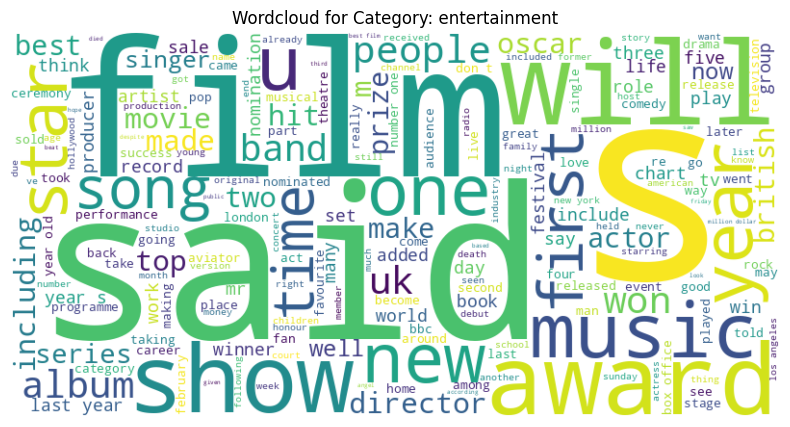

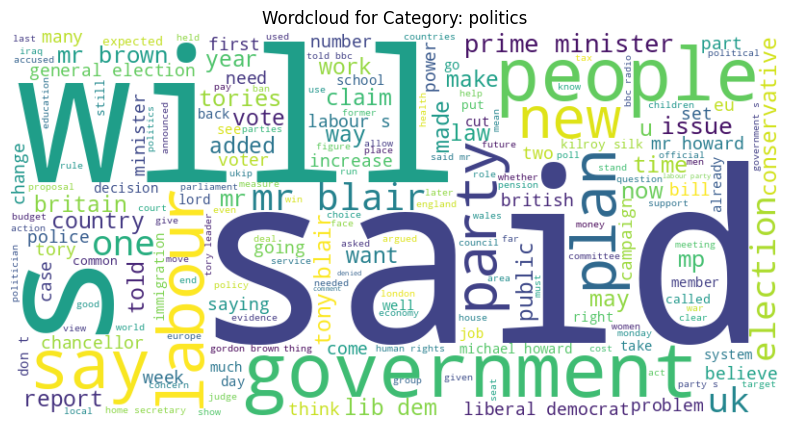

In [ ]:
# define functions to generate word clouds
def generate_wordcloud(category_text, category):
    # generate wordcloud
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(category_text)

    # display wordcloud
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(f'Wordcloud for Category: {category}')
    plt.axis('off')
    plt.show()

# generate wordcloud for each category
categories = df_re['category'].unique()
for category in categories:
    # filter data based on categories
    category_text = ' '.join(df_re[df_re['category'] == category]['text'])
    generate_wordcloud(category_text, category)

# Semantic Analysis

# Sentiment analysis: Polarity and Subjectivity

               polarity  subjectivity
tech           0.103772      0.432927
business       0.059707      0.383420
sport          0.112545      0.413391
entertainment  0.146573      0.392005
politics       0.068731      0.408942


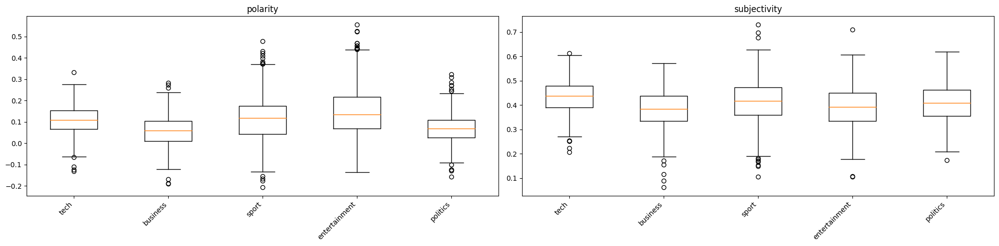

In [ ]:
# initializes an empty list in sentiment_features dictionary to save sentiment scores
sentiment_features = {label: [] for label in df_re['category'].unique()}

# iterate through the texts, create a TextBlob object for each text, and calculate its sentiment
for label in df_re['category'].unique():
    texts = df_re[df_re['category'] == label]['text']
# append the polarity and subjectivity scores to the corresponding category list
# in the sentiment_features dictionary
    for text in texts:
        sentiment = TextBlob(text).sentiment
        sentiment_features[label].append([sentiment.polarity, sentiment.subjectivity])

# construct a sentiment_stats dataframe that contains the mean polarity and subjectivity for each category
# by converting the lists of sentiment scores to a DataFrame and calculating the mean.
sentiment_stats = pd.DataFrame({label: pd.DataFrame(sentiment_features[label], columns=
 ['polarity', 'subjectivity']).mean() for label in df_re['category'].unique()}).transpose()

print(sentiment_stats)

# initialize Box plot
fig, axs = plt.subplots(1, 2, figsize=(20, 5))

# create a figure with two subplots
for i, feat in enumerate(['polarity', 'subjectivity']):
    data = [np.array(sentiment_features[label])[:, i] for label in df_re['category'].unique()]
    axs[i].boxplot(data, labels=df_re['category'].unique())
    axs[i].set_title(feat)
    axs[i].set_xticklabels(df_re['category'].unique(), rotation=45, ha='right')

# plot and display
plt.tight_layout()
plt.show()

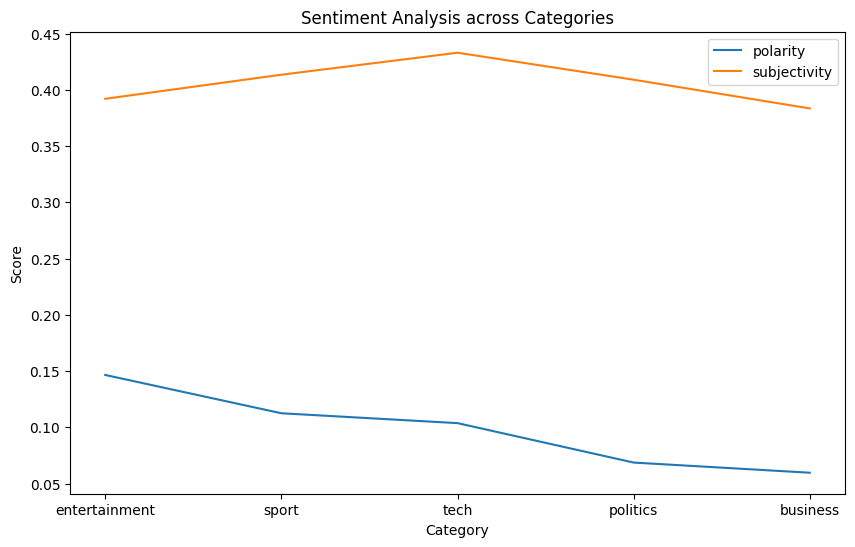

In [ ]:
# create a dataframe sentiment_stats from the mean polarity and subjectivity scores for
# each category, transpose for plotting, and sort by polarity
sentiment_stats = pd.DataFrame({
    label: pd.DataFrame(sentiment_features[label], columns=['polarity', 'subjectivity']).mean()
    for label in df_re['category'].unique()
}).transpose()
sentiment_stats = sentiment_stats.sort_values(by='polarity', ascending=False)

# initialize line chart
plt.figure(figsize=(10, 6))
for col in sentiment_stats.columns:
    plt.plot(sentiment_stats.index, sentiment_stats[col], label=col)

# plot and display
plt.xlabel('Category')
plt.ylabel('Score')
plt.title('Sentiment Analysis across Categories')
plt.legend()
plt.show()

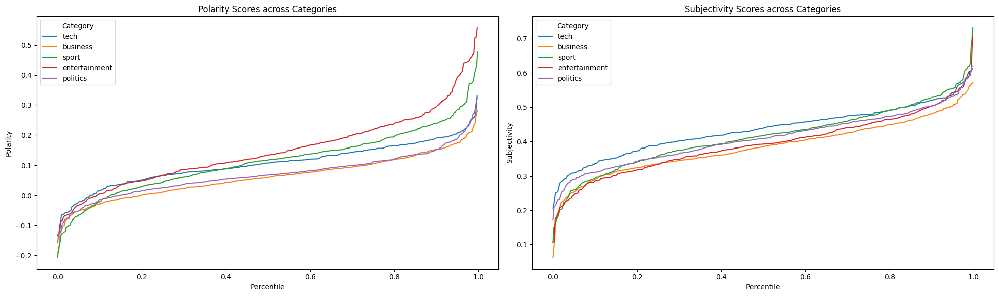

In [ ]:
# initialize sentiment_scores dictionary
sentiment_scores = {label: {'polarity': [], 'subjectivity': []} for label in df_re['category'].unique()}

# create a dictionary for polarity and subjectivity
for label in df_re['category'].unique():
    texts = df_re[df_re['category'] == label]['text']
    for text in texts:
        sentiment = TextBlob(text).sentiment
        sentiment_scores[label]['polarity'].append(sentiment.polarity)
        sentiment_scores[label]['subjectivity'].append(sentiment.subjectivity)

# initialize run chart
fig, axs = plt.subplots(1, 2, figsize=(20, 6))

# iterate over each text in the current category
for i, score_type in enumerate(['polarity', 'subjectivity']):
    for label in df_re['category'].unique():
        scores = sentiment_scores[label][score_type]
        sorted_scores = np.sort(scores)
        axs[i].plot(np.arange(len(sorted_scores)) / len(sorted_scores), sorted_scores, label=label)
    axs[i].set_xlabel('Percentile')
    axs[i].set_ylabel(score_type.capitalize())
    axs[i].set_title(f'{score_type.capitalize()} Scores across Categories')
    axs[i].legend(title='Category')

# plot and display
plt.tight_layout()
plt.show()

# Emotion Detection

<ipython-input-30-e37bd793c32c>:23: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = get_cmap('tab10')


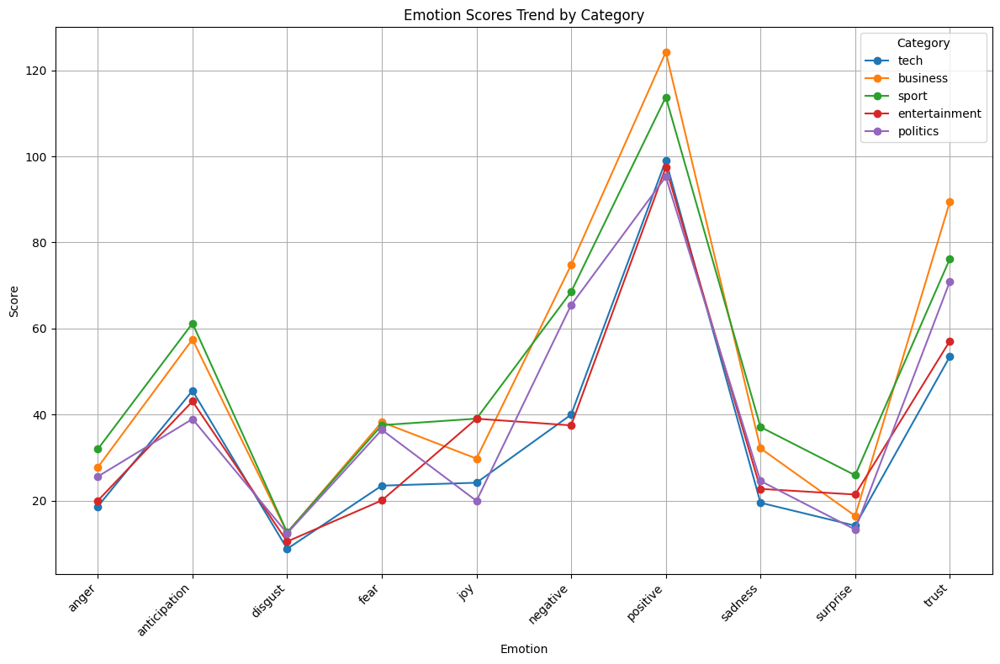

In [ ]:
# calculate the sentiment score of each text
def calculate_emotion_scores(text):
    emotion_detection = NRCLex(text)
    return emotion_detection.affect_frequencies

# create a dictionary to store the total sentiment score for each category
emotion_scores_by_category = defaultdict(lambda: defaultdict(float))

# iterate dataframe
for index, row in df_re.iterrows():
    label = row['category']
    text = row['text']
    # calculate the sentiment score of each text
    scores = calculate_emotion_scores(text)
    # accumulate sentiment scores for each category
    for emotion, score in scores.items():
        # normalize emotion labels
        if emotion.startswith('anticip'):
            emotion = 'anticipation'
        emotion_scores_by_category[label][emotion] += score

# color mapping
cmap = get_cmap('tab10')
plt.figure(figsize=(12, 8))

# iterate each category and plot sentiment score trends
for i, (label, scores) in enumerate(emotion_scores_by_category.items()):
    emotions = list(scores.keys())
    scores_values = [scores[emotion] for emotion in emotions]
    # sort
    sorted_emotions = sorted(emotions)
    sorted_scores = [scores[emotion] for emotion in sorted_emotions]
    # plot and display
    plt.plot(sorted_emotions, sorted_scores, marker='o', color=cmap(i), label=label)

# configures
plt.title('Emotion Scores Trend by Category')
plt.xticks(rotation=45, ha="right")
plt.xlabel('Emotion')
plt.ylabel('Score')
plt.grid(True)
plt.legend(title='Category')
plt.tight_layout()
plt.show()

# Temporal Recognition

In [ ]:
# create a dictionary to save dates found in each category
temporal_features = {label: [] for label in df_re['category'].unique()}

# iterate each unique category in the dataframe's 'category' column
# creates a series of texts by filtering the dataframe for entries that match the current category
for label in df_re['category'].unique():
    texts = df_re[df_re['category'] == label]['text']
    for text in texts:  # iterate each text within the current category
        matches = datefinder.find_dates(text) # find all dates within a piece of text and return an iterator of datetime objects
        temporal_features[label].extend([match.strftime('%Y-%m-%d') for match in matches])  # find all dates within a piece of text

# create a pandas dataframe from the temporal_features dictionary
temporal_stats = pd.DataFrame({label: pd.Series(Counter(temporal_features[label])) for label in df_re['category'].unique()}).fillna(0).astype(int)
temporal_stats['total'] = temporal_stats.sum(axis=1)
# print(temporal_stats.head(20))

# set option to display a maximum of 30 rows
pd.set_option('display.max_rows', 30)

# sort the DataFrame by the 'total' column in descending order and display the top 30 rows
print(temporal_stats.sort_values(by='total', ascending=False).head(30))

            tech  business  sport  entertainment  politics  total
2024-05-15   103       222     60             55       136    576
2024-04-15    73       120    143             73       102    511
2004-04-15    80       238     39             84        10    451
2024-04-01    56       251     17             61        39    424
2024-04-02   135       159     12             44        14    364
2024-04-21    41        58    130             73        60    362
2024-04-17    26        92    101             65        73    357
2024-04-20    45        36    137             82        46    346
2005-04-15   106       149     32             26        23    336
2024-04-10    60        65     58             74        41    298
2024-04-16    20        90     59             38        71    278
2024-04-18    22        79     53             52        70    276
2024-04-04    23       120     11             41        80    275
2024-04-19    20        82     63             64        41    270
2003-04-15

# Spatial Recognition:

In [ ]:
# store extracted geographical entities
spatial_features = {label: [] for label in df_re['category'].unique()}

# iterate unique categories in the dataset
# 'GPE' (countries, cities), 'LOC' (non-GPE locations), and 'FAC' (facilities like buildings)
for label in df_re['category'].unique():
    texts = df_re[df_re['category'] == label]['text']
    for text in texts:
        doc = nlp(text) # parse each text to doc
        ents = [ent.text for ent in doc.ents if ent.label_ in ['GPE', 'LOC', 'FAC']] # extract entities from doc.ents
        spatial_features[label].extend(ents)  # add entities to spatial_features under their respective category

# creat dataframe filled with zeros for missing values and converted to integers
spatial_stats = pd.DataFrame({
    label: pd.Series(Counter(spatial_features[label])) for label in df_re['category'].unique()
}).fillna(0).astype(int)
spatial_stats['total'] = spatial_stats.sum(axis=1)
# print(spatial_stats.head(20))

# set option to display all rows
pd.set_option('display.max_rows', 30)

# sort the DataFrame by the 'total' column, in descending order
sorted_spatial_stats = spatial_stats.sort_values(by='total', ascending=False)

# print the top 20 rows with the highest 'total'
print(sorted_spatial_stats.head(30))

                   tech  business  sport  entertainment  politics  total
us                  177       385     44            156        71    833
uk                  171       130      5            135       222    663
britain              28        10     79             45       241    403
london               46        95     55             97       102    395
europe              103       119     33             17        69    341
france               19        52    204             24        15    314
china                47       178      8              2        29    264
india                21       143      3             22         8    197
scotland              2         5    117              5        64    193
japan                56       102     14             16         5    193
england               1         2    106              6        57    172
italy                 6        26    113              3         2    150
iraq                  1        45      0           

# Spatial Recognition worldcloud

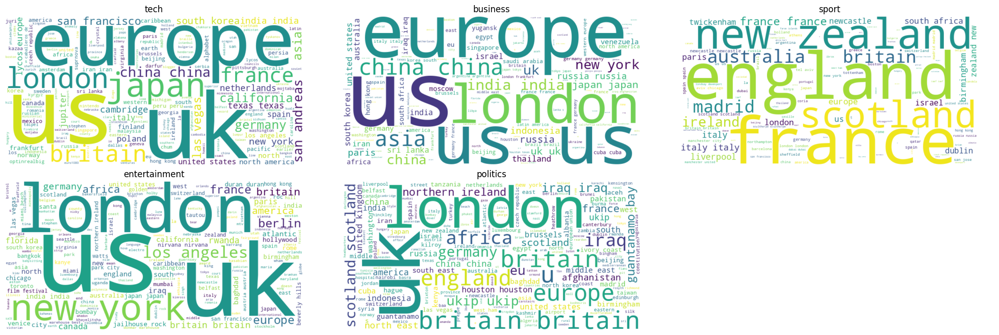

In [ ]:
# get the number of unique categories
unique_categories = df_re['category'].unique()
n_categories = len(unique_categories)

# calculate required subplot grid size
n_cols = 3
n_rows = (n_categories + n_cols - 1) // n_cols  # ensure for enough rows

# create an appropriately sized subplot grid
fig, axs = plt.subplots(n_rows, n_cols, figsize=(n_cols * 6.67, n_rows * 3.33))
axs = axs.ravel()  # necessary if there is only one row

# generate wordcloud for each category
for i, label in enumerate(unique_categories):
    text = ' '.join(spatial_features[label])
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)
    axs[i].imshow(wordcloud, interpolation='bilinear')
    axs[i].set_title(label)
    axs[i].axis('off')

# hide remaining empty subplots
for j in range(i+1, n_rows * n_cols):
    axs[j].axis('off')

# plot and display
plt.tight_layout()
plt.show()

# t-SNE visualization

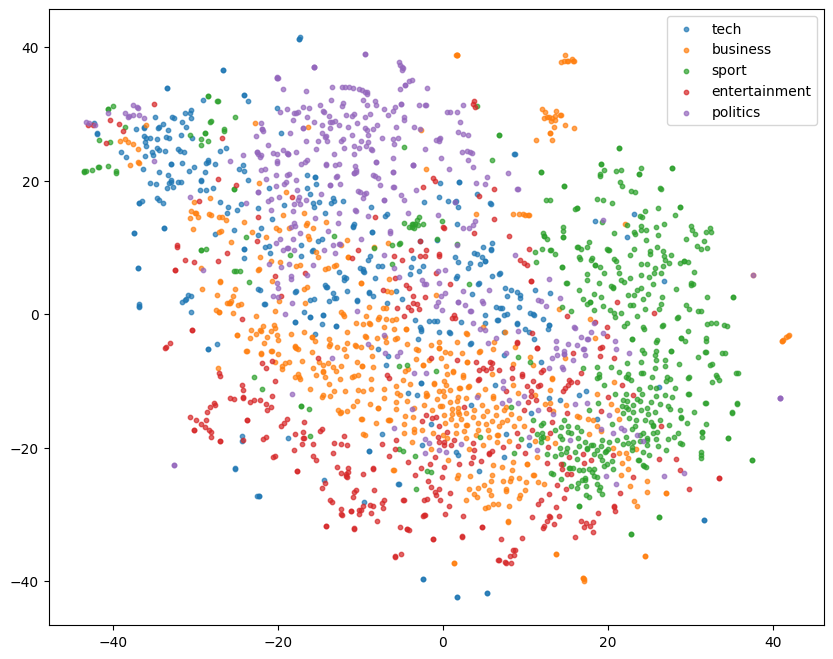

In [ ]:
# t-distributed Stochastic Neighbor Embedding (t-SNE) to reduce the high-dimensional
# text data into two dimensions, making it possible to visualize the text data
# project the data down to 2 dimensions (for plotting on a 2D graph)
# sets the random_state for reproducibility
vectorizer = CountVectorizer()
text_features = vectorizer.fit_transform(df_re['text'])
tsne = TSNE(n_components=2, random_state=42)
tsne_features = tsne.fit_transform(text_features.toarray())

# initialize t-SNE plot
plt.figure(figsize=(10, 8))
for label in df_re['category'].unique():
    mask = df_re['category'] == label
    plt.scatter(tsne_features[mask, 0], tsne_features[mask, 1], label=label, alpha=0.7, s=10)

# plot and display
plt.legend()
plt.show()

# Readibility

               count       mean       std  min  25%   50%   75%   max
tech           347.0  10.035159  1.465668  6.2  9.0  10.0  11.1  15.4
business       503.0   9.344732  1.556508  4.5  8.4   9.4  10.3  13.5
sport          504.0   8.411508  1.676604  4.1  7.3   8.3   9.5  18.2
entertainment  369.0   9.239024  1.519223  5.1  8.1   9.1  10.2  16.8
politics       403.0  10.320347  1.316517  6.3  9.4  10.3  11.2  14.3


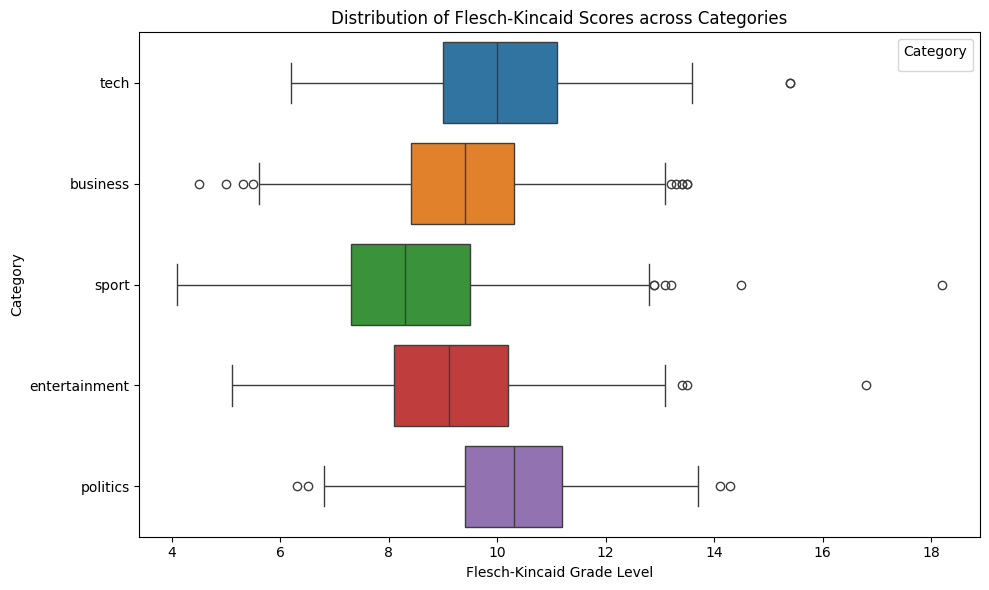

In [ ]:
# calculating various readability scores for text
!pip install textstat

import textstat

# Flesch-Kincaid Grade Level indicates the academic grade level required for someone to understand the text
# Flesch-Kincaid Grade Level scores for the text of each category in the df_re dataframe
fk_scores = {
    label: [textstat.flesch_kincaid_grade(text) for text in df_re[df_re['category'] == label]['text']]
    for label in df_re['category'].unique()
}

# create dataFrame fk_stats from the scores
fk_stats = pd.DataFrame({
    label: pd.Series(fk_scores[label]).describe()
    for label in df_re['category'].unique()
}).transpose()
print(fk_stats)
# create a long-form dataframe for Seaborn
long_form_df = pd.DataFrame([(label, score) for label, scores in fk_scores.items() for score in scores],
                            columns=['Category', 'FK_Score'])

# initialize Boxplot with hue
plt.figure(figsize=(10, 6))
sns.boxplot(data=long_form_df, y='Category', x='FK_Score', hue='Category', orient='h')

# Plot and display
plt.xlabel('Flesch-Kincaid Grade Level')
plt.ylabel('Category')
plt.title('Distribution of Flesch-Kincaid Scores across Categories')
plt.legend(title='Category')  # Add title to the legend
plt.tight_layout()
plt.show()

# BERT Tokenization, Padding and Truncation

In [ ]:
# load pretrained tokenizers and models (case-sensitive BERT versions)
tokenizer = BertTokenizer.from_pretrained('bert-base-cased')
model = BertModel.from_pretrained('bert-base-cased')

# word segmentation (convert each article into token IDs), perform Padding and Truncation for input into BERT
def tokenize_and_pad(text):
    encoded = tokenizer.encode_plus(  # Converts a string (text) and outputs a dictionary with several keys
        text,
        add_special_tokens=True,  # add [CLS] (start of sequence) and [SEP] (end of sequence) for BERT
        max_length=512, # set the maximum sequence length for tokens
        padding='max_length', # ensure all token sequences are padded to the same length (512) with padding tokens
        truncation=True,  # truncate text is longer than 512 tokens
        return_tensors='pt' # returned type will be a PyTorch tensor('pt')
    )
    return encoded['input_ids'].squeeze()

df_re['input_ids'] = df_re['text'].apply(tokenize_and_pad)  # store the results in a new column 'input_ids'

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


# Strartify sampling dataset into train set and test set

In [ ]:
# splits the dataset into training and testing sets
# X is the features (input_ids from text tokenization)
# y is the target variable (categories of texts)
# test_size=0.2 sets 20% of the data aside for testing
# random_state=42 ensures reproducibility
X = df_re['input_ids'].tolist()  # Make sure to convert the series of tensors to a list
y = df_re['category']

X_train, X_test, y_train, y_test = train_test_split(
    X, y, stratify=y, test_size=0.2, random_state=42
)

print("X_train shape:", len(X_train))
print("X_test shape:", len(X_test))
print("y_train shape:", y_train.shape)
print("y_test shape:", y_test.shape)

X_train shape: 1700
X_test shape: 426
y_train shape: (1700,)
y_test shape: (426,)


# Label encoding on Categories

In [ ]:
# y_train_encoded and y_test_encoded are now arrays of integers representing the categories
# create a label encoder object
label_encoder = LabelEncoder()

# fit the encoder to the training data and transform it to numeric labels
y_train_encoded = label_encoder.fit_transform(y_train.ravel())

# transform the test data to numeric labels based on the fitted encoder
y_test_encoded = label_encoder.transform(y_test.ravel())

# print the category label
for i, class_name in enumerate(label_encoder.classes_):
    print(f"label {i}: category '{class_name}'")

label 0: category 'business'
label 1: category 'entertainment'
label 2: category 'politics'
label 3: category 'sport'
label 4: category 'tech'


# Define BERT embedding function

In [ ]:
def batch_encode(model, input_ids):
    batch_size = 10
    embeddings = []
    for i in range(0, len(input_ids), batch_size):
        batch = input_ids[i:i+batch_size]
        # ensure to pad the sequences in the batch to the same length
        batch = torch.nn.utils.rnn.pad_sequence(batch, batch_first=True, padding_value=0)
        # create an attention mask for the batch
        attention_mask = (batch != 0)
        with torch.no_grad():
            outputs = model(batch, attention_mask=attention_mask)
        # retrieve the mean of the last hidden states
        embeddings.append(outputs.last_hidden_state.mean(dim=1).numpy())
    return np.concatenate(embeddings, axis=0)

# Contextualized word embeddings by BERT

In [ ]:
# perform BERT embeddings on training and test sets
X_train_embeddings = batch_encode(model, X_train)
X_test_embeddings = batch_encode(model, X_test)

# check shape
print("X_train_embeddings:", X_train_embeddings.shape)
print("X_test_embeddings:", X_test_embeddings.shape)

X_train_embeddings: (1700, 768)
X_test_embeddings: (426, 768)


# Dimensional reduction by UMAP

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


(1700, 2)
(426, 2)


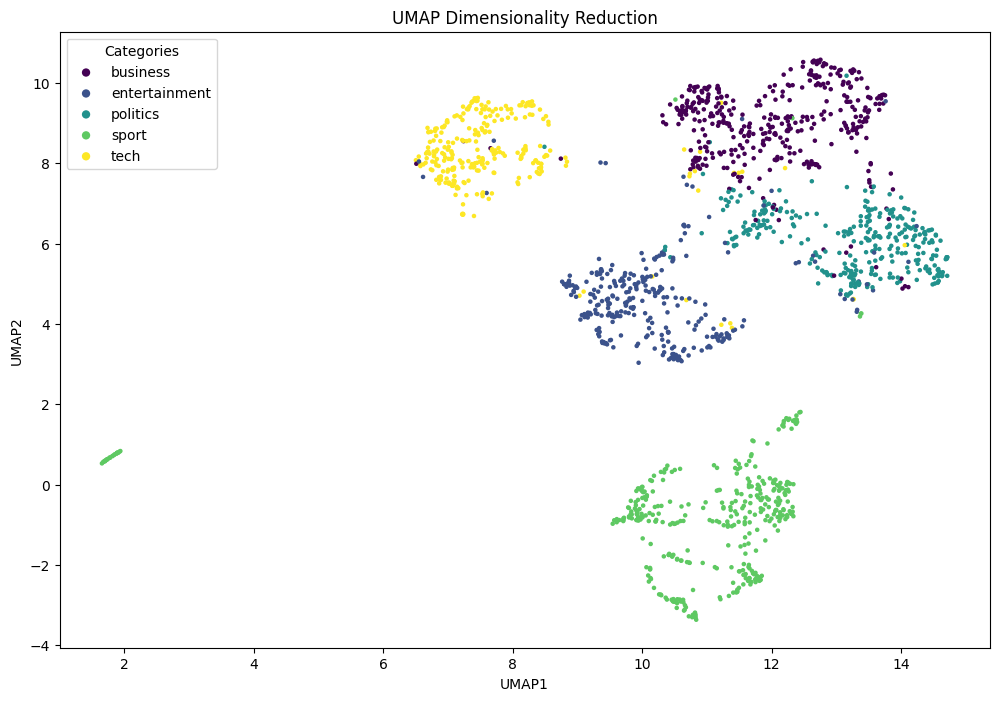

In [ ]:
# dimensional reduction by UMAP
reducer = umap.UMAP(random_state=42)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train_embeddings)
X_test_scaled = scaler.transform(X_test_embeddings)
X_train_umap = reducer.fit_transform(X_train_scaled)
X_test_umap = reducer.transform(X_test_scaled)

# check shape
print(X_train_umap.shape)
print(X_test_umap.shape)

# use original category name to get colors
unique_labels = np.unique(y_train_encoded)
category_colors = plt.cm.viridis(np.linspace(0, 1, len(unique_labels)))
color_map = dict(zip(unique_labels, category_colors))

# create a color map with original category names as keys
scatter_colors = [color_map[label] for label in y_train_encoded]

# UMAP visualization
plt.figure(figsize=(12, 8))
scatter = plt.scatter(X_train_umap[:, 0], X_train_umap[:, 1], c=scatter_colors, s=5)
plt.title('UMAP Dimensionality Reduction')
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')

# create a colorbar label using the original category name
legend_handles = [plt.scatter([], [], marker='o', color=color_map[label], label=label_encoder.inverse_transform([label])[0],
                              edgecolors='none')
for label in unique_labels]
plt.legend(handles=legend_handles, title="Categories")

plt.show()

# Define Fucntions for Machine Learning Classifiers

# Define Data Preprocessing Function for Machine Learning Classifiers

In [ ]:
def prepare_training_test_data(X_train_umap, X_test_umap, y_train_encoded, y_test_encoded):
    """
    prepare traning set and test set

    parameters:
        X_train_umap (np.array): training feature array (after UMAP dimensionality reduction)
        X_test_umap (np.array): test feature array (after UMAP dimensionality reduction)
        y_train_encoded (np.array): training label array (after label encoding)
        y_test_encoded (np.array): test label array (after label encoding)

    return prepared training and test data sets.
        X_train_umap, y_train_encoded, X_test_umap, y_test_encoded
    """
    return X_train_umap, y_train_encoded, X_test_umap, y_test_encoded

# Defifne Evaluate Function for Machine Learning Classifiers

In [ ]:
# evaluates model performance precision, recall, F1 and confusion matrix on a test set
def evaluate_model(model, X_test_umap, y_test_encoded):
    y_pred_encoded = model.predict(X_test_umap) # predicts the categories (y_pred_encoded) of the test set (X_test_umap)
    y_test = label_encoder.inverse_transform(y_test_encoded)  # converts both the predicted and actual labels (y_test_encoded)
    y_pred = label_encoder.inverse_transform(y_pred_encoded)  # back to their original form using an inverse transform
    results = {
        'precision': precision_score(y_test, y_pred, average='macro'),
        'recall': recall_score(y_test, y_pred, average='macro'),
        'f1': f1_score(y_test, y_pred, average='macro'),
        'conf_matrix': confusion_matrix(y_test, y_pred),
    }
    return results

# Define Training Function for Machine Learning Classifiers

In [ ]:
# trains a model using Grid Search with cross-validation
# initializes a K-Fold cross-validation process with 10 splits
# shuffling the data and using a fixed random state for reproducibility
# scoring method (accuracy), the K-Fold cross-validator, and parallel processing (n_jobs=-1) for efficiency
# fits the model to the training data (X_train_umap, y_train_encoded)
# prints the best hyperparameters
def train_model(model, param_grid, X_train_umap, y_train_encoded):
    kfold = KFold(n_splits=3, shuffle=True, random_state=42)
    grid_search = GridSearchCV(estimator=model, param_grid=param_grid, scoring='accuracy', cv=kfold, n_jobs=-1, verbose=1)
    grid_search.fit(X_train_umap, y_train_encoded)
    print("Best parameters:", grid_search.best_params_)
    return grid_search.best_estimator_

# Define Cross-Validation Evaluation Function for Machine Learning Classifiers

In [ ]:
# cross-validation on the training data
def evaluate_with_cross_validation(model, X_train_umap, y_train_encoded):
    kfold = KFold(n_splits=10, shuffle=True, random_state=42) # shuffling the data to ensure randomness
    scores = cross_val_score(model, X_train_umap, y_train_encoded, scoring='accuracy', cv=kfold)  # using accuracyc for ross-validation scores
    print(f'Cross-Validation Accuracy: {np.mean(scores):.3f}')

# Define Evaluation Function on test set for Machine Learning Classifiers

In [ ]:
# evaluates performance on a test dataset
def evaluate_on_test_set(model, X_test_umap, y_test_encoded):
    y_pred_encoded = model.predict(X_test_umap) # predict outcomes for the test set
    y_test = label_encoder.inverse_transform(y_test_encoded)  # compares these predictions to the actual labels
    y_pred = label_encoder.inverse_transform(y_pred_encoded)  #  (after transforming both from encoded forms to their original labels)

    # metrics
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='macro')
    recall = recall_score(y_test, y_pred, average='macro')
    f1 = f1_score(y_test, y_pred, average='macro')
    conf_matrix = confusion_matrix(y_test, y_pred)
    report = classification_report(y_test, y_pred)

    print(f'Test Accuracy: {accuracy:.3f}')
    print(f'Test Precision: {precision:.3f}')
    print(f'Test Recall: {recall:.3f}')
    print(f'Test F1: {f1:.3f}')
    print('Confusion Matrix:\n', conf_matrix)
    print('Classification Report:\n', report)

# Define Plot Learning Function for Machine Learning Classifiers

In [ ]:
# learning curve represents the model's training and validation accuracy
def plot_learning_curve(model, X_train_umap, y_train_encoded, cv):
    train_sizes, train_scores, test_scores = learning_curve(
        model,
        X_train_umap,
        y_train_encoded,
        cv=cv,
        scoring='accuracy',
        n_jobs=-1  #  n_jobs=-1 use all available CPUs to perform its operations
        )

    # calculate mean and standard deviation for training and test set scores
    train_mean = np.mean(train_scores, axis=1)
    test_mean = np.mean(test_scores, axis=1)

    # plot and display
    plt.figure(figsize=(8, 6))
    plt.plot(train_sizes, train_mean, label='Training Score')
    plt.plot(train_sizes, test_mean, label='Test Score')
    plt.xlabel('Training Examples')
    plt.ylabel('Accuracy')
    plt.title('Learning Curve')
    plt.legend()
    plt.show()

# Define Error Analysis Function for Machine Learning

In [ ]:
# predict the labels for the test set and compares them to the true labels
def analyze_error_samples(model, X_test_umap, y_test_encoded, num_samples=10):
    y_pred_encoded = model.predict(X_test_umap) # generate predictions for the test set
    y_test = label_encoder.inverse_transform(y_test_encoded)  # convert numerical labels back to their original
    y_pred = label_encoder.inverse_transform(y_pred_encoded)  # categorical labels for both the true and predicted labels
    incorrect_indices = np.where(y_pred != y_test)[0] # find the indices in the test set that the predicted labels don't match the true labels
    print(f"Total incorrect predictions: {len(incorrect_indices)}")

    label_errors = {} # track the number of errors for each label
    label_counts = {}

    # count errors by label for each incorrectly predicted true label
    # calculates the percentage of errors
    for idx in incorrect_indices:
        true_label = y_test[idx]
        if true_label not in label_errors:
            label_errors[true_label] = 0
        label_errors[true_label] += 1

    # iterate each unique label in the test dataset
    for label in np.unique(y_test):
        label_counts[label] = np.sum(y_test == label)

    # calculate percentage of statistics for each true label
    print("Error statistics by label:")
    for label, error_count in label_errors.items():
        total_count = label_counts[label]
        error_percentage = error_count / total_count * 100
        print(f"Label {label}: {error_count}/{total_count} incorrect predictions ({error_percentage:.2f}%)")

    # display sample errors
    print("\nSample incorrect predictions:")
    for idx in incorrect_indices[:num_samples]:
        true_label = y_test[idx]
        predicted_label = y_pred[idx]
        print(f"True label: {true_label}, Predicted label: {predicted_label}")
        print("-" * 50)

# Machine Learning Classifiers Training

# Logistic Regression

Fitting 3 folds for each of 6 candidates, totalling 18 fits


/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid = os.fork()


Best parameters: {'C': 1, 'penalty': 'l2'}
Cross-Validation Accuracy: 0.934
Test Accuracy: 0.925
Test Precision: 0.931
Test Recall: 0.916
Test F1: 0.922
Confusion Matrix:
 [[ 97   0   1   0   3]
 [  0  66   3   3   2]
 [  7   1  72   1   0]
 [  0   0   0 101   0]
 [ 10   0   1   0  58]]
Classification Report:
                precision    recall  f1-score   support

     business       0.85      0.96      0.90       101
entertainment       0.99      0.89      0.94        74
     politics       0.94      0.89      0.91        81
        sport       0.96      1.00      0.98       101
         tech       0.92      0.84      0.88        69

     accuracy                           0.92       426
    macro avg       0.93      0.92      0.92       426
 weighted avg       0.93      0.92      0.92       426



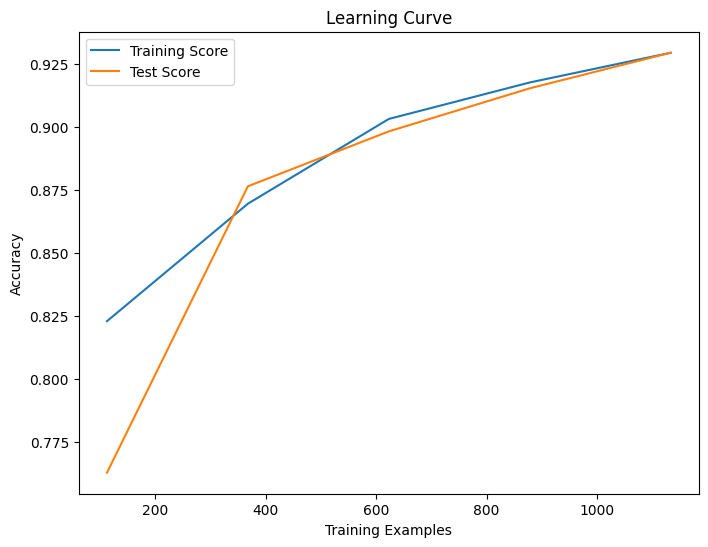

Total incorrect predictions: 32
Error statistics by label:
Label tech: 11/69 incorrect predictions (15.94%)
Label entertainment: 8/74 incorrect predictions (10.81%)
Label politics: 9/81 incorrect predictions (11.11%)
Label business: 4/101 incorrect predictions (3.96%)

Sample incorrect predictions:
True label: tech, Predicted label: business
--------------------------------------------------
True label: entertainment, Predicted label: sport
--------------------------------------------------
True label: politics, Predicted label: business
--------------------------------------------------
True label: politics, Predicted label: business
--------------------------------------------------
True label: politics, Predicted label: sport
--------------------------------------------------
True label: entertainment, Predicted label: politics
--------------------------------------------------
True label: business, Predicted label: tech
--------------------------------------------------
True label:

In [ ]:
# define Logistic Regression momdel
# solver='liblinear' is the algorithm to use in the optimization problem
# max_iter means the optimization process can iterate up to 10,000 times before stopping
model = LogisticRegression(solver='liblinear', max_iter=10000)

# define parameter grid
# create a list of values for the inverse of regularization strength 'C',
# used to prevent overfitting by penalizing large coefficients in the model
# 'l2' penalty is the standard used in logistic regression, which penalizes the square of the coefficients
 # ,also known as Ridge regression or L2 norm
param_grid = {
    'C': [0.001, 0.01, 0.1, 1, 10, 100],
    'penalty': ['l2']
}

# call train_model function
best_model = train_model(model, param_grid, X_train_umap, y_train_encoded)

# call evaluate_with_cross_validation function
evaluate_with_cross_validation(best_model, X_train_umap, y_train_encoded)

# call evaluate_on_test_set function
evaluate_on_test_set(best_model, X_test_umap, y_test_encoded)

# call plot_learning_curve function
kfold = KFold(n_splits=3, shuffle=True, random_state=42)
plot_learning_curve(best_model, X_train_umap, y_train_encoded, cv=kfold)

# call analyze_error_samples function
analyze_error_samples(best_model, X_test_umap, y_test_encoded)

# Kernel SVM : Linear, Radial Basis Function Kernel(RBF), Polynomial, Sigmoid

Fitting 3 folds for each of 48 candidates, totalling 144 fits
Best parameters: {'C': 0.01, 'gamma': 'auto', 'kernel': 'poly'}
Cross-Validation Accuracy: 0.948
Test Accuracy: 0.951
Test Precision: 0.951
Test Recall: 0.946
Test F1: 0.948
Confusion Matrix:
 [[ 95   0   3   0   3]
 [  0  71   1   0   2]
 [  1   0  79   1   0]
 [  0   0   0 101   0]
 [  9   0   1   0  59]]
Classification Report:
                precision    recall  f1-score   support

     business       0.90      0.94      0.92       101
entertainment       1.00      0.96      0.98        74
     politics       0.94      0.98      0.96        81
        sport       0.99      1.00      1.00       101
         tech       0.92      0.86      0.89        69

     accuracy                           0.95       426
    macro avg       0.95      0.95      0.95       426
 weighted avg       0.95      0.95      0.95       426



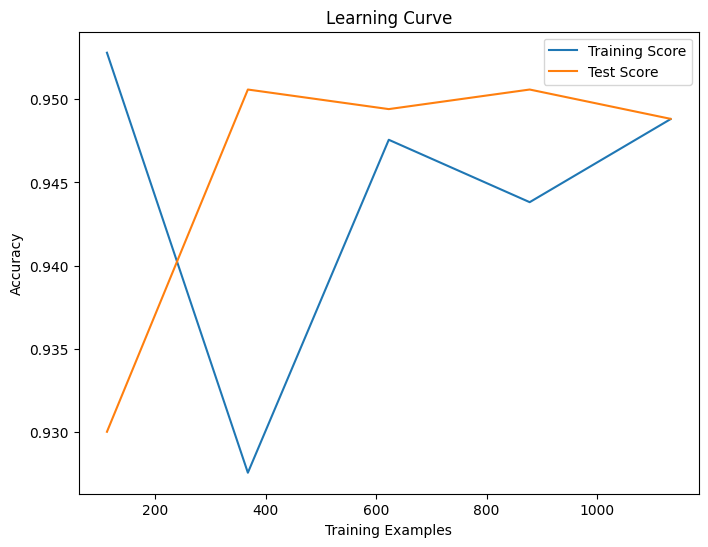

Total incorrect predictions: 21
Error statistics by label:
Label politics: 2/81 incorrect predictions (2.47%)
Label entertainment: 3/74 incorrect predictions (4.05%)
Label business: 6/101 incorrect predictions (5.94%)
Label tech: 10/69 incorrect predictions (14.49%)

Sample incorrect predictions:
True label: politics, Predicted label: business
--------------------------------------------------
True label: politics, Predicted label: sport
--------------------------------------------------
True label: entertainment, Predicted label: politics
--------------------------------------------------
True label: business, Predicted label: tech
--------------------------------------------------
True label: business, Predicted label: politics
--------------------------------------------------
True label: business, Predicted label: politics
--------------------------------------------------
True label: tech, Predicted label: business
--------------------------------------------------
True label: tec

In [ ]:
# define SVC model
model = SVC()

# define parameter grid
# 'linear': Linear kernel for linearly separable data
# 'rbf': Radial basis function for non-linear data
# 'poly': Polynomial kernel for non-linear data that can be separated with a polynomial decision boundary
# 'sigmoid': Sigmoid kernel that is similar to the logistic regression
# 'gamma': ['scale', 'auto']: define the coefficient for non-linear kernels ('rbf', 'poly', and 'sigmoid')
# 'gamma' defines the influence a single training example is
  # the higher the gamma value, the closer other examples must be to be affected
# 'scale' and 'auto' are ways to use a heuristic to find the right gamma value
param_grid = {
    'C': [0.001, 0.01, 0.1, 1, 10, 100],
    'kernel': ['linear', 'rbf', 'poly', 'sigmoid'],
    'gamma': ['scale', 'auto']
}

# call train_model function
best_model = train_model(model, param_grid, X_train_umap, y_train_encoded)

# call evaluate_with_cross_validation function
evaluate_with_cross_validation(best_model, X_train_umap, y_train_encoded)

# call evaluate_on_test_set function
evaluate_on_test_set(best_model, X_test_umap, y_test_encoded)

# call plot_learning_curve function
kfold = KFold(n_splits=3, shuffle=True, random_state=42)
plot_learning_curve(best_model, X_train_umap, y_train_encoded, cv=kfold)

# call analyze_error_samples function
analyze_error_samples(best_model, X_test_umap, y_test_encoded)

# Softmax Regression

Fitting 3 folds for each of 6 candidates, totalling 18 fits
Best parameters: {'C': 10}
Cross-Validation Accuracy: 0.945
Test Accuracy: 0.948
Test Precision: 0.948
Test Recall: 0.944
Test F1: 0.946
Confusion Matrix:
 [[ 96   0   2   0   3]
 [  0  71   1   0   2]
 [  2   2  76   1   0]
 [  0   0   0 101   0]
 [  8   0   1   0  60]]
Classification Report:
                precision    recall  f1-score   support

     business       0.91      0.95      0.93       101
entertainment       0.97      0.96      0.97        74
     politics       0.95      0.94      0.94        81
        sport       0.99      1.00      1.00       101
         tech       0.92      0.87      0.90        69

     accuracy                           0.95       426
    macro avg       0.95      0.94      0.95       426
 weighted avg       0.95      0.95      0.95       426



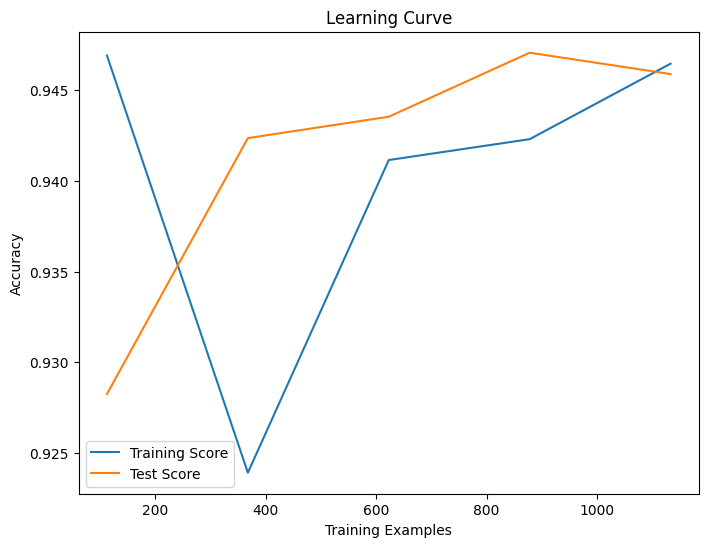

Total incorrect predictions: 22
Error statistics by label:
Label politics: 5/81 incorrect predictions (6.17%)
Label entertainment: 3/74 incorrect predictions (4.05%)
Label business: 5/101 incorrect predictions (4.95%)
Label tech: 9/69 incorrect predictions (13.04%)

Sample incorrect predictions:
True label: politics, Predicted label: business
--------------------------------------------------
True label: politics, Predicted label: sport
--------------------------------------------------
True label: entertainment, Predicted label: politics
--------------------------------------------------
True label: business, Predicted label: tech
--------------------------------------------------
True label: politics, Predicted label: entertainment
--------------------------------------------------
True label: business, Predicted label: politics
--------------------------------------------------
True label: tech, Predicted label: business
--------------------------------------------------
True label:

In [ ]:
# define Softmax Regression (Multinomial Logistic Regression) model
model = LogisticRegression(multi_class='multinomial', solver='lbfgs', max_iter=10000)

# define parameter grid
param_grid = {
    'C': [0.001, 0.01, 0.1, 1, 10, 100],
}

# call train_model function
best_model = train_model(model, param_grid, X_train_umap, y_train_encoded)

# call evaluate_with_cross_validation function
evaluate_with_cross_validation(best_model, X_train_umap, y_train_encoded)

# call evaluate_on_test_set function
evaluate_on_test_set(best_model, X_test_umap, y_test_encoded)

# call plot_learning_curve function
kfold = KFold(n_splits=3, shuffle=True, random_state=42)
plot_learning_curve(best_model, X_train_umap, y_train_encoded, cv=kfold)

# call analyze_error_samples function
analyze_error_samples(best_model, X_test_umap, y_test_encoded)

# k-Nearest Neighbors

Fitting 3 folds for each of 16 candidates, totalling 48 fits


/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid = os.fork()


Best parameters: {'metric': 'manhattan', 'n_neighbors': 7, 'weights': 'distance'}
Cross-Validation Accuracy: 0.948
Test Accuracy: 0.948
Test Precision: 0.948
Test Recall: 0.943
Test F1: 0.945
Confusion Matrix:
 [[ 96   0   2   0   3]
 [  0  70   1   1   2]
 [  1   1  78   1   0]
 [  0   0   0 101   0]
 [  8   1   1   0  59]]
Classification Report:
                precision    recall  f1-score   support

     business       0.91      0.95      0.93       101
entertainment       0.97      0.95      0.96        74
     politics       0.95      0.96      0.96        81
        sport       0.98      1.00      0.99       101
         tech       0.92      0.86      0.89        69

     accuracy                           0.95       426
    macro avg       0.95      0.94      0.95       426
 weighted avg       0.95      0.95      0.95       426



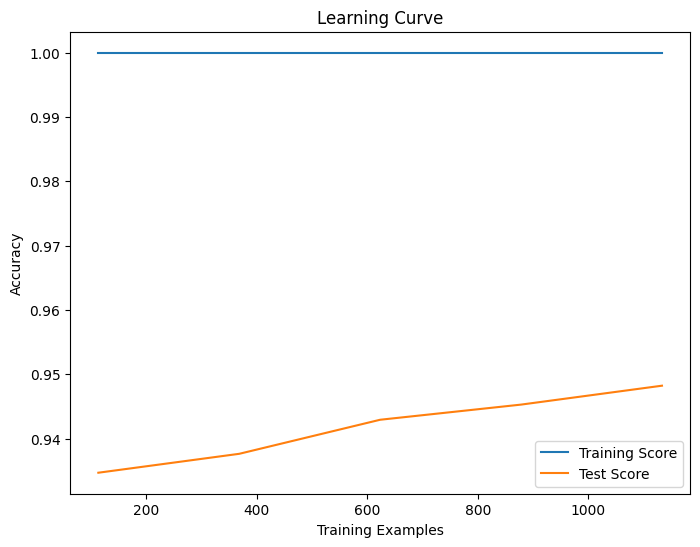

Total incorrect predictions: 22
Error statistics by label:
Label tech: 10/69 incorrect predictions (14.49%)
Label politics: 3/81 incorrect predictions (3.70%)
Label business: 5/101 incorrect predictions (4.95%)
Label entertainment: 4/74 incorrect predictions (5.41%)

Sample incorrect predictions:
True label: tech, Predicted label: entertainment
--------------------------------------------------
True label: politics, Predicted label: business
--------------------------------------------------
True label: politics, Predicted label: sport
--------------------------------------------------
True label: business, Predicted label: tech
--------------------------------------------------
True label: entertainment, Predicted label: sport
--------------------------------------------------
True label: business, Predicted label: politics
--------------------------------------------------
True label: tech, Predicted label: business
--------------------------------------------------
True label: tech,

In [ ]:
# define KNN model
model = KNeighborsClassifier()

# define parameter grid
# 'n_neighbors': the number of neighbors to use for the k-nearest neighbors vote
# 'weights': ['uniform', 'distance']: the weight function used in prediction
# 'uniform' means all points in each neighborhood are weighted equally
# 'distance' assigns weights proportional to the inverse of the distance from the query point
  # closer neighbors have a greater influence than further away neighbors
# 'metric': the distance metric used for the tree
# 'euclidean': the standard distance measure in space and suitable for all the inputs have the same units
# 'manhattan' (L1 norm): distance metric to consider a path grid-like path from point to point (such as city blocks)
param_grid = {
    'n_neighbors': [3, 5, 7, 9],
    'weights': ['uniform', 'distance'],
    'metric': ['euclidean', 'manhattan']
}

# call train_model function
best_model = train_model(model, param_grid, X_train_umap, y_train_encoded)

# call evaluate_with_cross_validation function
evaluate_with_cross_validation(best_model, X_train_umap, y_train_encoded)

# call evaluate_on_test_set function
evaluate_on_test_set(best_model, X_test_umap, y_test_encoded)

# call plot_learning_curve function
kfold = KFold(n_splits=3, shuffle=True, random_state=42)
plot_learning_curve(best_model, X_train_umap, y_train_encoded, cv=kfold)

# call analyze_error_samples function
analyze_error_samples(best_model, X_test_umap, y_test_encoded)

# Decision Tree

Fitting 3 folds for each of 27 candidates, totalling 81 fits
Best parameters: {'max_depth': 5, 'min_samples_leaf': 1, 'min_samples_split': 5}
Cross-Validation Accuracy: 0.942
Test Accuracy: 0.951
Test Precision: 0.950
Test Recall: 0.946
Test F1: 0.948
Confusion Matrix:
 [[ 96   0   2   0   3]
 [  0  71   0   0   3]
 [  3   0  77   1   0]
 [  0   0   0 101   0]
 [  6   2   1   0  60]]
Classification Report:
                precision    recall  f1-score   support

     business       0.91      0.95      0.93       101
entertainment       0.97      0.96      0.97        74
     politics       0.96      0.95      0.96        81
        sport       0.99      1.00      1.00       101
         tech       0.91      0.87      0.89        69

     accuracy                           0.95       426
    macro avg       0.95      0.95      0.95       426
 weighted avg       0.95      0.95      0.95       426



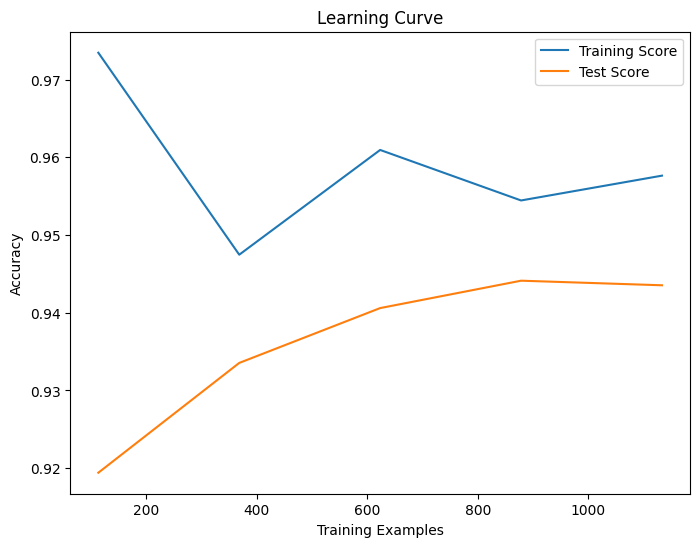

Total incorrect predictions: 21
Error statistics by label:
Label tech: 9/69 incorrect predictions (13.04%)
Label politics: 4/81 incorrect predictions (4.94%)
Label business: 5/101 incorrect predictions (4.95%)
Label entertainment: 3/74 incorrect predictions (4.05%)

Sample incorrect predictions:
True label: tech, Predicted label: entertainment
--------------------------------------------------
True label: politics, Predicted label: business
--------------------------------------------------
True label: politics, Predicted label: business
--------------------------------------------------
True label: politics, Predicted label: sport
--------------------------------------------------
True label: business, Predicted label: tech
--------------------------------------------------
True label: business, Predicted label: politics
--------------------------------------------------
True label: tech, Predicted label: business
--------------------------------------------------
True label: tech, Pr

In [ ]:
# define the Decision Tree model
model = DecisionTreeClassifier()

# define parameter grid
param_grid = {
    'max_depth': [None, 5, 10], # maximum depth of the tree
    'min_samples_split': [2, 5, 10],  # minimum number of samples required to split an internal node
    'min_samples_leaf': [1, 2, 4] # minimum number of samples required to be at a leaf node
}

# call train_model function
best_model = train_model(model, param_grid, X_train_umap, y_train_encoded)

# call evaluate_with_cross_validation function
evaluate_with_cross_validation(best_model, X_train_umap, y_train_encoded)

# call evaluate_on_test_set function
evaluate_on_test_set(best_model, X_test_umap, y_test_encoded)

# call plot_learning_curve function
kfold = KFold(n_splits=3, shuffle=True, random_state=42)
plot_learning_curve(best_model, X_train_umap, y_train_encoded, cv=kfold)

# call analyze_error_samples function
analyze_error_samples(best_model, X_test_umap, y_test_encoded)

# Random Forest

Fitting 3 folds for each of 81 candidates, totalling 243 fits
Best parameters: {'max_depth': None, 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 100}
Cross-Validation Accuracy: 0.949
Test Accuracy: 0.953
Test Precision: 0.952
Test Recall: 0.948
Test F1: 0.950
Confusion Matrix:
 [[ 96   0   2   0   3]
 [  0  72   0   0   2]
 [  1   1  78   1   0]
 [  0   0   0 101   0]
 [  8   1   1   0  59]]
Classification Report:
                precision    recall  f1-score   support

     business       0.91      0.95      0.93       101
entertainment       0.97      0.97      0.97        74
     politics       0.96      0.96      0.96        81
        sport       0.99      1.00      1.00       101
         tech       0.92      0.86      0.89        69

     accuracy                           0.95       426
    macro avg       0.95      0.95      0.95       426
 weighted avg       0.95      0.95      0.95       426



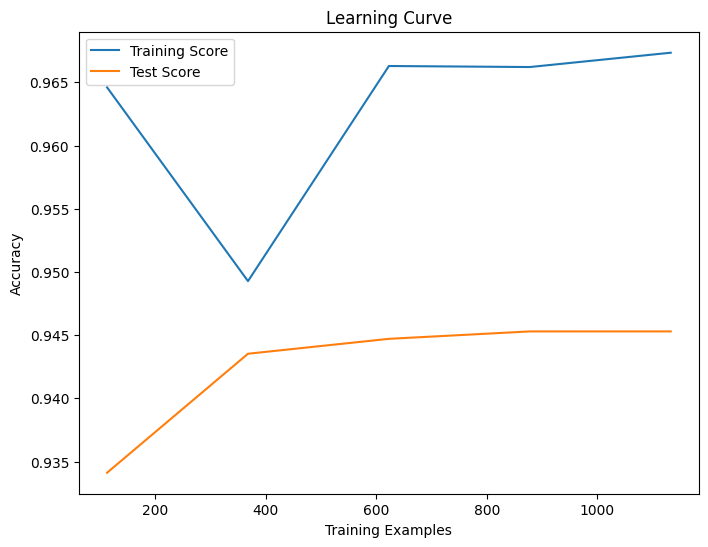

Total incorrect predictions: 20
Error statistics by label:
Label tech: 10/69 incorrect predictions (14.49%)
Label politics: 3/81 incorrect predictions (3.70%)
Label business: 5/101 incorrect predictions (4.95%)
Label entertainment: 2/74 incorrect predictions (2.70%)

Sample incorrect predictions:
True label: tech, Predicted label: entertainment
--------------------------------------------------
True label: politics, Predicted label: business
--------------------------------------------------
True label: politics, Predicted label: sport
--------------------------------------------------
True label: business, Predicted label: tech
--------------------------------------------------
True label: business, Predicted label: politics
--------------------------------------------------
True label: tech, Predicted label: business
--------------------------------------------------
True label: tech, Predicted label: business
--------------------------------------------------
True label: business, P

In [ ]:
# define the Random Forest model
model = RandomForestClassifier()

# define parameter grid
param_grid = {
    'n_estimators': [100, 200, 300],  # the number of trees in the forest
    'max_depth': [None, 5, 10], # maximum depth of the trees
    'min_samples_split': [2, 5, 10],  # minimum number of samples required to split an internal node
    'min_samples_leaf': [1, 2, 4] # minimum number of samples required to be at a leaf node
}

# call train_model function
best_model = train_model(model, param_grid, X_train_umap, y_train_encoded)

# call evaluate_with_cross_validation function
evaluate_with_cross_validation(best_model, X_train_umap, y_train_encoded)

# call evaluate_on_test_set function
evaluate_on_test_set(best_model, X_test_umap, y_test_encoded)

# call plot_learning_curve function
kfold = KFold(n_splits=3, shuffle=True, random_state=42)
plot_learning_curve(best_model, X_train_umap, y_train_encoded, cv=kfold)

# call analyze_error_samples function
analyze_error_samples(best_model, X_test_umap, y_test_encoded)

# Gradient Tree Boosting

Fitting 3 folds for each of 54 candidates, totalling 162 fits
Best parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 200, 'subsample': 0.8}
Cross-Validation Accuracy: 0.949
Test Accuracy: 0.939
Test Precision: 0.940
Test Recall: 0.932
Test F1: 0.935
Confusion Matrix:
 [[ 96   0   2   0   3]
 [  0  72   0   0   2]
 [  2   3  75   1   0]
 [  0   0   0 101   0]
 [ 11   2   0   0  56]]
Classification Report:
                precision    recall  f1-score   support

     business       0.88      0.95      0.91       101
entertainment       0.94      0.97      0.95        74
     politics       0.97      0.93      0.95        81
        sport       0.99      1.00      1.00       101
         tech       0.92      0.81      0.86        69

     accuracy                           0.94       426
    macro avg       0.94      0.93      0.93       426
 weighted avg       0.94      0.94      0.94       426



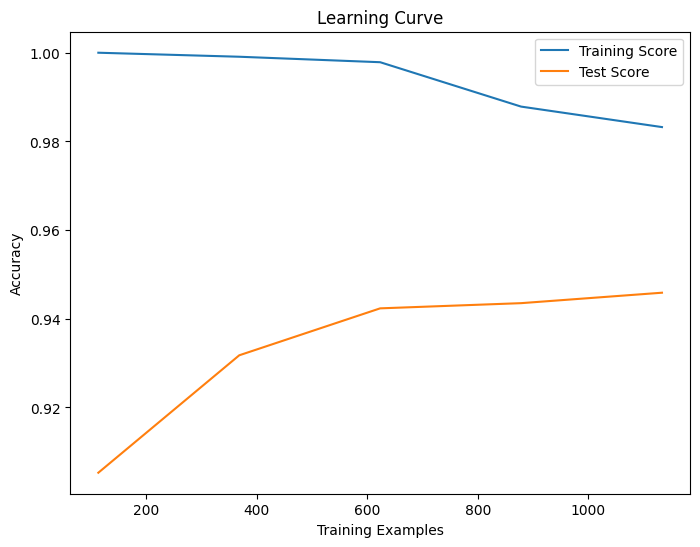

Total incorrect predictions: 26
Error statistics by label:
Label tech: 13/69 incorrect predictions (18.84%)
Label politics: 6/81 incorrect predictions (7.41%)
Label business: 5/101 incorrect predictions (4.95%)
Label entertainment: 2/74 incorrect predictions (2.70%)

Sample incorrect predictions:
True label: tech, Predicted label: entertainment
--------------------------------------------------
True label: politics, Predicted label: business
--------------------------------------------------
True label: politics, Predicted label: business
--------------------------------------------------
True label: politics, Predicted label: sport
--------------------------------------------------
True label: business, Predicted label: tech
--------------------------------------------------
True label: business, Predicted label: politics
--------------------------------------------------
True label: tech, Predicted label: business
--------------------------------------------------
True label: tech, P

In [ ]:
# define the Gradient Tree Boosting model
model = GradientBoostingClassifier()

# define parameter grid
param_grid = {
    'n_estimators': [100, 200, 300],  #  the number of boosting stages (trees) to be used in the ensemble
    'learning_rate': [0.1, 0.05, 0.01], # scale the contribution of each tree
    'max_depth': [3, 5, 7], # maximum depth of each individual tree
    'subsample': [0.8, 1.0] # fraction of samples to be used for fitting each individual base learners
}

# call train_model function
best_model = train_model(model, param_grid, X_train_umap, y_train_encoded)

# call evaluate_with_cross_validation function
evaluate_with_cross_validation(best_model, X_train_umap, y_train_encoded)

# call evaluate_on_test_set function
evaluate_on_test_set(best_model, X_test_umap, y_test_encoded)

# call plot_learning_curve function
kfold = KFold(n_splits=3, shuffle=True, random_state=42)
plot_learning_curve(best_model, X_train_umap, y_train_encoded, cv=kfold)

# call analyze_error_samples function
analyze_error_samples(best_model, X_test_umap, y_test_encoded)

# XGBoost

Fitting 3 folds for each of 648 candidates, totalling 1944 fits
Best parameters: {'colsample_bytree': 1.0, 'gamma': 0.1, 'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 200, 'subsample': 1.0}
Cross-Validation Accuracy: 0.950
Test Accuracy: 0.927
Test Precision: 0.928
Test Recall: 0.921
Test F1: 0.923
Confusion Matrix:
 [[ 95   0   2   0   4]
 [  0  70   0   2   2]
 [  4   5  71   1   0]
 [  0   0   0 101   0]
 [  9   1   1   0  58]]
Classification Report:
                precision    recall  f1-score   support

     business       0.88      0.94      0.91       101
entertainment       0.92      0.95      0.93        74
     politics       0.96      0.88      0.92        81
        sport       0.97      1.00      0.99       101
         tech       0.91      0.84      0.87        69

     accuracy                           0.93       426
    macro avg       0.93      0.92      0.92       426
 weighted avg       0.93      0.93      0.93       426



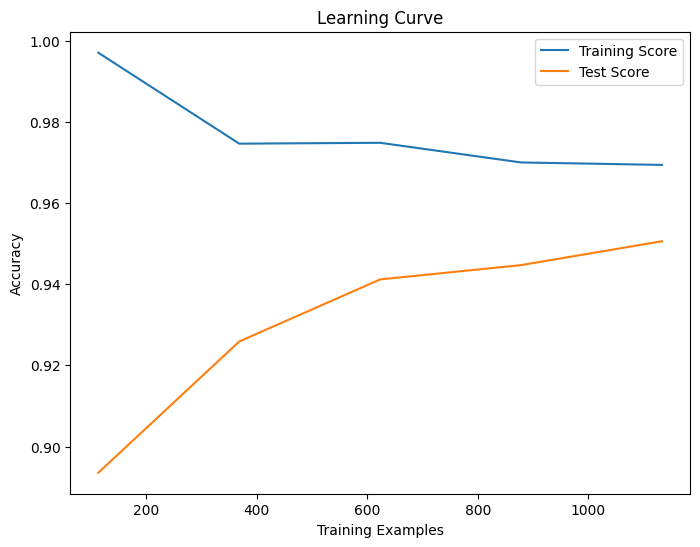

Total incorrect predictions: 31
Error statistics by label:
Label tech: 11/69 incorrect predictions (15.94%)
Label politics: 10/81 incorrect predictions (12.35%)
Label business: 6/101 incorrect predictions (5.94%)
Label entertainment: 4/74 incorrect predictions (5.41%)

Sample incorrect predictions:
True label: tech, Predicted label: business
--------------------------------------------------
True label: politics, Predicted label: business
--------------------------------------------------
True label: politics, Predicted label: business
--------------------------------------------------
True label: politics, Predicted label: sport
--------------------------------------------------
True label: business, Predicted label: tech
--------------------------------------------------
True label: politics, Predicted label: entertainment
--------------------------------------------------
True label: entertainment, Predicted label: sport
--------------------------------------------------
True label:

In [ ]:
# define the XGBoost model
model = XGBClassifier()

# define parameter grid
param_grid = {
    'n_estimators': [100, 200, 300],  # number of gradient boosted trees
    'learning_rate': [0.1, 0.05, 0.01], # step size shrinkage used to prevent overfitting; Range is [0,1]
    'max_depth': [3, 5, 7], # maximum tree depth for base learners
    'subsample': [0.8, 1.0],  # subsample ratio of the training instances to prevent overfitting
    'colsample_bytree': [0.6, 0.8, 1.0],  # subsample ratio of columns when constructing each tree
    'gamma': [0, 0.1, 0.2, 0.3] # minimum loss reduction required to make a further partition on a leaf node of the tree
                                  # to control overfitting, the higher the model is more conservative
}

# call train_model function
best_model = train_model(model, param_grid, X_train_umap, y_train_encoded)

# call evaluate_with_cross_validation function
evaluate_with_cross_validation(best_model, X_train_umap, y_train_encoded)

# call evaluate_on_test_set function
evaluate_on_test_set(best_model, X_test_umap, y_test_encoded)

# call plot_learning_curve function
kfold = KFold(n_splits=3, shuffle=True, random_state=42)
plot_learning_curve(best_model, X_train_umap, y_train_encoded, cv=kfold)

# call analyze_error_samples function
analyze_error_samples(best_model, X_test_umap, y_test_encoded)

# ADABoost

Fitting 3 folds for each of 9 candidates, totalling 27 fits
Best parameters: {'learning_rate': 1.0, 'n_estimators': 50}
Cross-Validation Accuracy: 0.841
Test Accuracy: 0.901
Test Precision: 0.903
Test Recall: 0.891
Test F1: 0.893
Confusion Matrix:
 [[96  0  3  0  2]
 [ 0 72  0  0  2]
 [ 0 10 70  1  0]
 [ 0  0  0 98  3]
 [20  0  1  0 48]]
Classification Report:
                precision    recall  f1-score   support

     business       0.83      0.95      0.88       101
entertainment       0.88      0.97      0.92        74
     politics       0.95      0.86      0.90        81
        sport       0.99      0.97      0.98       101
         tech       0.87      0.70      0.77        69

     accuracy                           0.90       426
    macro avg       0.90      0.89      0.89       426
 weighted avg       0.90      0.90      0.90       426



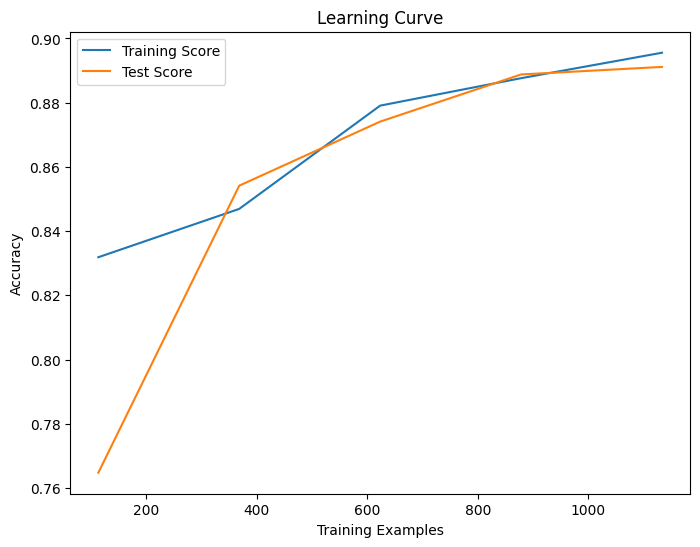

Total incorrect predictions: 42
Error statistics by label:
Label tech: 21/69 incorrect predictions (30.43%)
Label politics: 11/81 incorrect predictions (13.58%)
Label business: 5/101 incorrect predictions (4.95%)
Label sport: 3/101 incorrect predictions (2.97%)
Label entertainment: 2/74 incorrect predictions (2.70%)

Sample incorrect predictions:
True label: tech, Predicted label: business
--------------------------------------------------
True label: politics, Predicted label: entertainment
--------------------------------------------------
True label: politics, Predicted label: sport
--------------------------------------------------
True label: business, Predicted label: tech
--------------------------------------------------
True label: politics, Predicted label: entertainment
--------------------------------------------------
True label: sport, Predicted label: tech
--------------------------------------------------
True label: politics, Predicted label: entertainment
------------

In [ ]:
# define the AdaBoost model
model = AdaBoostClassifier()

# define parameter grid
# n_estimators': determine the maximum number of weak learners (or models) that will be added to the ensemble
  # each successive model focuses on the instances that previous models misclassified
  # more estimators often lead to better performance but can lead to overfitting and increased computational cost
# 'learning_rate': the contribution of each model to the final combination
  # higher learning rate means each successive model attempts to correct its predecessor more aggressively
param_grid = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.1, 0.5, 1.0]  # the contribution of each model to the final combination
}

# call train_model function
best_model = train_model(model, param_grid, X_train_umap, y_train_encoded)

# call evaluate_with_cross_validation function
evaluate_with_cross_validation(best_model, X_train_umap, y_train_encoded)

# call evaluate_on_test_set function
evaluate_on_test_set(best_model, X_test_umap, y_test_encoded)

# call plot_learning_curve function
kfold = KFold(n_splits=3, shuffle=True, random_state=42)
plot_learning_curve(best_model, X_train_umap, y_train_encoded, cv=kfold)

# call analyze_error_samples function
analyze_error_samples(best_model, X_test_umap, y_test_encoded)

# Binary Relevance

Fitting 3 folds for each of 6 candidates, totalling 18 fits
Best parameters: {'estimator__C': 10, 'estimator__kernel': 'rbf'}
Cross-Validation Accuracy: 0.944
Test Accuracy: 0.948
Test Precision: 0.949
Test Recall: 0.943
Test F1: 0.946
Confusion Matrix:
 [[ 95   0   3   0   3]
 [  0  70   2   0   2]
 [  1   0  79   1   0]
 [  0   0   0 101   0]
 [  9   0   1   0  59]]
Classification Report:
                precision    recall  f1-score   support

     business       0.90      0.94      0.92       101
entertainment       1.00      0.95      0.97        74
     politics       0.93      0.98      0.95        81
        sport       0.99      1.00      1.00       101
         tech       0.92      0.86      0.89        69

     accuracy                           0.95       426
    macro avg       0.95      0.94      0.95       426
 weighted avg       0.95      0.95      0.95       426



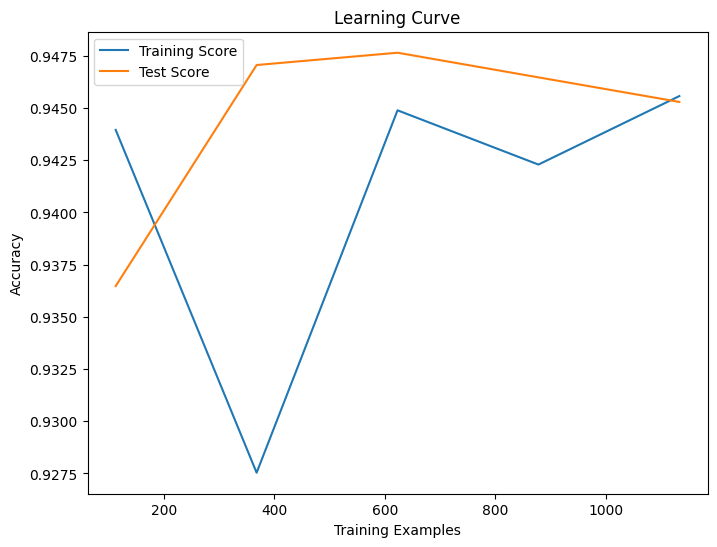

Total incorrect predictions: 22
Error statistics by label:
Label politics: 2/81 incorrect predictions (2.47%)
Label entertainment: 4/74 incorrect predictions (5.41%)
Label business: 6/101 incorrect predictions (5.94%)
Label tech: 10/69 incorrect predictions (14.49%)

Sample incorrect predictions:
True label: politics, Predicted label: business
--------------------------------------------------
True label: politics, Predicted label: sport
--------------------------------------------------
True label: entertainment, Predicted label: politics
--------------------------------------------------
True label: business, Predicted label: tech
--------------------------------------------------
True label: business, Predicted label: politics
--------------------------------------------------
True label: business, Predicted label: politics
--------------------------------------------------
True label: tech, Predicted label: business
--------------------------------------------------
True label: tec

In [ ]:
# define Binary Relevance model using SVC as base classifier
model = OneVsRestClassifier(SVC())

# define parameter grid
# 'linear': good for linearly separable data
# 'rbf': effective for non-linearly separable data
param_grid = {
    'estimator__C': [0.1, 1, 10],
    'estimator__kernel': ['linear', 'rbf']
}

# call train_model function
best_model = train_model(model, param_grid, X_train_umap, y_train_encoded)

# call evaluate_with_cross_validation function
evaluate_with_cross_validation(best_model, X_train_umap, y_train_encoded)

# call evaluate_on_test_set function
evaluate_on_test_set(best_model, X_test_umap, y_test_encoded)

# call plot_learning_curve function
kfold = KFold(n_splits=3, shuffle=True, random_state=42)
plot_learning_curve(best_model, X_train_umap, y_train_encoded, cv=kfold)

# call analyze_error_samples function
analyze_error_samples(best_model, X_test_umap, y_test_encoded)

# Gaussian Naive Bayes

Fitting 3 folds for each of 5 candidates, totalling 15 fits
Best parameters: {'var_smoothing': 1e-09}
Cross-Validation Accuracy: 0.941
Test Accuracy: 0.948
Test Precision: 0.949
Test Recall: 0.944
Test F1: 0.946
Confusion Matrix:
 [[ 96   0   2   0   3]
 [  0  71   1   0   2]
 [  3   1  76   1   0]
 [  0   0   0 101   0]
 [  8   0   1   0  60]]
Classification Report:
                precision    recall  f1-score   support

     business       0.90      0.95      0.92       101
entertainment       0.99      0.96      0.97        74
     politics       0.95      0.94      0.94        81
        sport       0.99      1.00      1.00       101
         tech       0.92      0.87      0.90        69

     accuracy                           0.95       426
    macro avg       0.95      0.94      0.95       426
 weighted avg       0.95      0.95      0.95       426



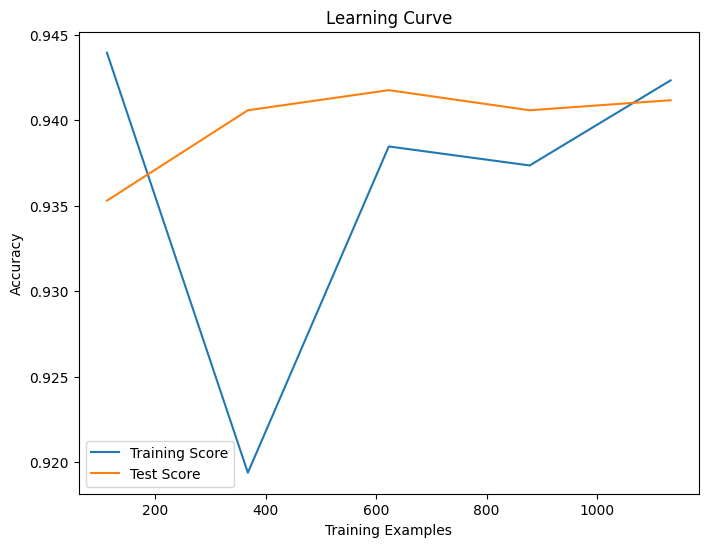

Total incorrect predictions: 22
Error statistics by label:
Label politics: 5/81 incorrect predictions (6.17%)
Label entertainment: 3/74 incorrect predictions (4.05%)
Label business: 5/101 incorrect predictions (4.95%)
Label tech: 9/69 incorrect predictions (13.04%)

Sample incorrect predictions:
True label: politics, Predicted label: business
--------------------------------------------------
True label: politics, Predicted label: business
--------------------------------------------------
True label: politics, Predicted label: sport
--------------------------------------------------
True label: entertainment, Predicted label: politics
--------------------------------------------------
True label: business, Predicted label: tech
--------------------------------------------------
True label: business, Predicted label: politics
--------------------------------------------------
True label: business, Predicted label: politics
--------------------------------------------------
True label: 

In [ ]:
from sklearn.naive_bayes import GaussianNB

# define Gaussian Naive Bayes Classifier
model = GaussianNB()

# define parameter grid
# specify the portion of the largest variance of all features that is added to variances for calculation stability
  # acts as a smoothing factor to avoid numerical issues during the fit and when making predictions
  # smaller values (less smoothing) makes the model more sensitive to the data but may overfit
param_grid = {
    'var_smoothing': [1e-9, 1e-8, 1e-7, 1e-6, 1e-5]
}

# call train_model function
best_model = train_model(model, param_grid, X_train_umap, y_train_encoded)

# call evaluate_with_cross_validation function
evaluate_with_cross_validation(best_model, X_train_umap, y_train_encoded)

# call evaluate_on_test_set function
evaluate_on_test_set(best_model, X_test_umap, y_test_encoded)

# call plot_learning_curve function
kfold = KFold(n_splits=3, shuffle=True, random_state=42)
plot_learning_curve(best_model, X_train_umap, y_train_encoded, cv=kfold)

# call analyze_error_samples function
analyze_error_samples(best_model, X_test_umap, y_test_encoded)

# Sequential Model

# BERT Tokenization

In [ ]:
# rename df_re as df_re_nn
df_re_nn = df_re.copy()

# load pretrained tokenizers and models (case-sensitive BERT versions)
tokenizer = BertTokenizer.from_pretrained('bert-base-cased')
model = BertModel.from_pretrained('bert-base-cased')

# word segmentation (convert each article into token IDs), perform Padding and Truncation for input into BERT
def tokenize_and_pad_nn(text):
    encoded = tokenizer.encode_plus(  # convert a string (text) and outputs a dictionary with several keys
        text,
        add_special_tokens=True,  # add [CLS] (start of sequence) and [SEP] (end of sequence) for BERT
        max_length=512, # set the maximum sequence length for tokens
        padding='max_length', # ensure all token sequences are padded to the same length (512) with padding tokens
        truncation=True,  # truncate text is longer than 512 tokens
        return_tensors='pt' # returned type will be a PyTorch tensor('pt')
    )
    return encoded['input_ids'].squeeze()

df_re_nn['input_ids'] = df_re_nn['text'].apply(tokenize_and_pad_nn) # store the results in a new column 'input_ids'

# Stratify sampling dataset(df_re) into train set, validation set and test set

In [ ]:
# split df_re_nn into training set, validation set and test set
X = df_re_nn['text']
y = df_re_nn['category']

X_train_nn, X_temp_nn, y_train_nn, y_temp_nn = train_test_split(X, y, test_size=0.3, stratify=y, random_state=42)
X_val_nn, X_test_nn, y_val_nn, y_test_nn = train_test_split(X_temp_nn, y_temp_nn, test_size=0.5, stratify=y_temp_nn, random_state=42)

# number of samples in each dataset
print("Training set size:", len(X_train_nn))
print("Validation set size:", len(X_val_nn))
print("Test set size:", len(X_test_nn))

# check the size of the label datasets
print("Training labels size:", len(y_train_nn))
print("Validation labels size:", len(y_val_nn))
print("Test labels size:", len(y_test_nn))

Training set size: 1488
Validation set size: 319
Test set size: 319
Training labels size: 1488
Validation labels size: 319
Test labels size: 319


# Define BERT embedding function

In [ ]:
def batch_encode_nn(model, texts, tokenizer):
    batch_size = 10
    embeddings = []
    for i in range(0, len(texts), batch_size):  # loop iterates over the texts list in increments of batch_size
        batch = texts[i:i+batch_size]
        encoded_input = tokenizer(
            batch,  # process the texts in batches of 10
            padding=True,
            truncation=True,
            max_length=512,
            return_tensors='pt'
            )
        with torch.no_grad(): # disable gradient calculations to save memory and computations (not needed during inference)
            outputs = model(**encoded_input)
        embeddings.append(outputs.last_hidden_state.mean(dim=1).numpy())
    return np.concatenate(embeddings, axis=0) # concatenates all the embedding arrays stored in the embeddings list along axis=0 (stack vertically),
                                                # resulting in a single NumPy array containing embeddings for all texts processed

# BERT Embedding on text

In [ ]:
# BERT Embedding on training set, validation set, and test set
X_train_nn_embeddings = batch_encode_nn(model, X_train_nn.tolist(), tokenizer)
X_val_nn_embeddings = batch_encode_nn(model, X_val_nn.tolist(), tokenizer)
X_test_nn_embeddings = batch_encode_nn(model, X_test_nn.tolist(), tokenizer)

# check shape
print(X_train_nn_embeddings.shape)
print(X_val_nn_embeddings.shape)
print(X_test_nn_embeddings.shape)

(1488, 768)
(319, 768)
(319, 768)


# Label Encoding on Categories

In [ ]:
# Label Encoding the categories of the training set, validation set, and test set
label_encoder_nn = LabelEncoder()

y_train_nn_encoded = label_encoder_nn.fit_transform(y_train_nn)
y_val_nn_encoded = label_encoder_nn.transform(y_val_nn)
y_test_nn_encoded = label_encoder_nn.transform(y_test_nn)

# print the category label
for i, class_name in enumerate(label_encoder_nn.classes_):
    print(f"label {i}: category '{class_name}'")

# print labeld categories and size
print("Size of encoded training labels:", len(y_train_nn_encoded))
print("Size of encoded validation labels:", len(y_val_nn_encoded))
print("Size of encoded test labels:", len(y_test_nn_encoded))

label 0: category 'business'
label 1: category 'entertainment'
label 2: category 'politics'
label 3: category 'sport'
label 4: category 'tech'
Size of encoded training labels: 1488
Size of encoded validation labels: 319
Size of encoded test labels: 319


# Use UMAP for Dimensionality Reduction on Text

In [ ]:
# UMAP dimensionality reduction on the training set, validation set and test set
reducer = umap.UMAP(random_state=42)
scaler = StandardScaler()

X_train_nn_scaled = scaler.fit_transform(X_train_nn_embeddings)
X_val_nn_scaled = scaler.transform(X_val_nn_embeddings)
X_test_nn_scaled = scaler.transform(X_test_nn_embeddings)

X_train_nn_umap = reducer.fit_transform(X_train_nn_scaled)
X_val_nn_umap = reducer.transform(X_val_nn_scaled)
X_test_nn_umap = reducer.transform(X_test_nn_scaled)

# check shape
print(X_train_nn_umap.shape)
print(X_val_nn_umap.shape)
print(X_test_nn_umap.shape)

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


(1488, 2)
(319, 2)
(319, 2)


# Define Model Compile Functions

In [ ]:
# five categories
num_classes = 5

# define model complie functions
def build_model_label_encoding(hp):
    model = Sequential()

    # search the size of the hidden layer
    dense_layer_sizes = hp.Int('dense_layer_sizes', min_value=64, max_value=1024, step=64)
    # search activation function
    activation_choice = hp.Choice('activation', values=['relu', 'elu', 'selu', 'leaky_relu'])

    # defining the first layer of a Sequential model
    # dense_layer_sizes: number of neurons in the layer
    # activation function choice in search
    # He normal(pre-defined) initializer used to initialize weights based on
      # a Gaussian distribution where the standard deviation is calculated as sqrt(2/number_of_inputs)
    # input shape 768 need to equal to the features embedding by BERT
    model.add(Dense(dense_layer_sizes, activation=activation_choice, kernel_initializer='he_normal', input_shape=(X_train_nn_umap.shape[1],)))

    # search dropout rate
    # hp.Choice: use Keras Tuner hyperparameter tuning will try different launch functions specified in the activation_choice
    # test different dropout rates between 0.0 and 0.5, in increments of 0.1
    dropout_rate = hp.Float('dropout_rate', min_value=0.0, max_value=0.5, step=0.1)

    # adds a Dropout layer to the neural network model
    model.add(Dropout(dropout_rate))


    # add an additional hidden layer
    model.add(Dense(512, activation=activation_choice, kernel_initializer='he_normal'))

    # another dropout layer to help prevent overfitting
    model.add(Dropout(dropout_rate))

    # use softmax activation function for multi-class classification
      # and output a probability distribution over the 5 classes
    model.add(Dense(num_classes, activation="softmax"))

    # search optimizers and learning rates as a method of tuning hyperparameters
    # optimizer hyperparameter chooses between "adam" and "sgd" (Stochastic Gradient Descent) using hp.Choice
    optimizer = hp.Choice('optimizer', values=['adam', 'sgd'])

    # learning_rate is defined with hp.Float
    # setting a range between 1e-4 to 1e-2 with logarithmic sampling ('LOG')
    learning_rate = hp.Float('learning_rate', min_value=1e-4, max_value=1e-2, sampling='LOG')

    # checks the value chosen for the optimizer hyperparameter and
      # initializes the corresponding optimizer with the determined learning_rate
    if optimizer == 'adam':
        optimizer = Adam(learning_rate=learning_rate)
    else:
        optimizer = SGD(learning_rate=learning_rate)

    # categorical_crossentropy as loss function for classification task
    loss = 'sparse_categorical_crossentropy'

    # optimizer variable is used to minimize the loss function during training
      # during hyperparameter tuning process
    # loss parameter specifies the loss function to be optimized
    # model's performance evaluated based on accuracy
    model.compile(optimizer=optimizer, loss=loss, metrics=['accuracy'])

    return model

# Lable Encoding Training Sequential Model:

In [ ]:
# define callback functions for early stopping and learning rate adjustment

# define callback functions for early stopping and learning rate adjustment
# EarlyStopping stops training when  val_accuracy stops improving
# patience=5: waits for 5 epochs without improvement in validation accuracy before stopping
# restore_best_weights
early_stop = EarlyStopping(monitor='val_accuracy', patience=5, mode='max', restore_best_weights=True)

# ReduceLROnPlateau: reduces the learning rate when a metric stops improving
# factor=0.1 the learning rate is reduced by a factor of 0.1 if val_accuracy doesn't improve for 3 epochs (patience=3)
# verbose = 0: no log outputs
#  "max": training will stop or be adjustmented if the 'val_accuracy' stopped increasing
  # for metrics like accuracy, higher values are better
reduce_lr = ReduceLROnPlateau(monitor='val_accuracy', factor=0.1, patience=3, mode='max')

# create log directory for TensorBoard
log_dir = os.path.join('/content/drive/My Drive/Colab Notebooks', 'tuner_results_labenc', 'bbc_text_classification', 'logs')
tensorboard_callback = TensorBoard(log_dir=log_dir, histogram_freq=1)

# set model save path
model_path = os.path.join(log_dir, 'best_model.keras')

# ensure path exist
os.makedirs(log_dir, exist_ok=True)

# initialize random search
tuner = RandomSearch(
    build_model_label_encoding,
    objective='val_accuracy',
    max_trials=30,
    executions_per_trial=3,
    directory='tuner_results_labenc',
    project_name='bbc_text_classification',
    seed=42
)

# search for the best parameters
tuner.search(
    X_train_nn_umap,
    y_train_nn_encoded,
    epochs=50,
    batch_size=64,
    validation_data=(X_val_nn_umap, y_val_nn_encoded),
    callbacks=[early_stop, reduce_lr, tensorboard_callback],
    verbose=2
)

# get the best model
best_model = tuner.get_best_models(num_models=1)[0]

Trial 30 Complete [00h 00m 13s]
val_accuracy: 0.7617554863293966

Best val_accuracy So Far: 0.9582027196884155
Total elapsed time: 00h 07m 33s


In [ ]:
best_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 384)               1152      
                                                                 
 dropout (Dropout)           (None, 384)               0         
                                                                 
 dense_1 (Dense)             (None, 512)               197120    
                                                                 
 dropout_1 (Dropout)         (None, 512)               0         
                                                                 
 dense_2 (Dense)             (None, 5)                 2565      
                                                                 
Total params: 200837 (784.52 KB)
Trainable params: 200837 (784.52 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
best_hp = tuner.get_best_hyperparameters(num_trials=1)[0]
print(best_hp.values)

{'dense_layer_sizes': 384, 'activation': 'selu', 'dropout_rate': 0.0, 'optimizer': 'adam', 'learning_rate': 0.0003069273045576997}


In [ ]:
tuner.results_summary()

Results summary
Results in tuner_results_labenc/bbc_text_classification
Showing 10 best trials
Objective(name="val_accuracy", direction="max")

Trial 1 summary
Hyperparameters:
dense_layer_sizes: 384
activation: selu
dropout_rate: 0.0
optimizer: adam
learning_rate: 0.0003069273045576997
Score: 0.950888196627299

Trial 24 summary
Hyperparameters:
dense_layer_sizes: 64
activation: selu
dropout_rate: 0.0
optimizer: adam
learning_rate: 0.00022773443777239995
Score: 0.9456635316212972

Trial 23 summary
Hyperparameters:
dense_layer_sizes: 640
activation: selu
dropout_rate: 0.1
optimizer: adam
learning_rate: 0.0010874771484415556
Score: 0.9446186224619547

Trial 09 summary
Hyperparameters:
dense_layer_sizes: 192
activation: elu
dropout_rate: 0.0
optimizer: adam
learning_rate: 0.00014690651027379393
Score: 0.9352142016092936

Trial 2 summary
Hyperparameters:
dense_layer_sizes: 1024
activation: selu
dropout_rate: 0.4
optimizer: adam
learning_rate: 0.008547485565344062
Score: 0.9226750334103903


In [ ]:
!ls tuner_results_labenc/bbc_text_classification

logs	     trial_06  trial_1	 trial_13  trial_17  trial_20  trial_24  trial_28  tuner0.json
oracle.json  trial_07  trial_10  trial_14  trial_18  trial_21  trial_25  trial_29
trial_0      trial_08  trial_11  trial_15  trial_19  trial_22  trial_26  trial_3
trial_05     trial_09  trial_12  trial_16  trial_2   trial_23  trial_27  trial_4


Epoch 1/50
24/24 [==============================] - 2s 21ms/step - loss: 2.8537 - accuracy: 0.6196 - val_loss: 0.8840 - val_accuracy: 0.7398 - lr: 3.0693e-04
Epoch 2/50
24/24 [==============================] - 0s 7ms/step - loss: 0.6785 - accuracy: 0.8340 - val_loss: 0.3638 - val_accuracy: 0.9185 - lr: 3.0693e-04
Epoch 3/50
24/24 [==============================] - 0s 7ms/step - loss: 0.4631 - accuracy: 0.8864 - val_loss: 0.3207 - val_accuracy: 0.9091 - lr: 3.0693e-04
Epoch 4/50
24/24 [==============================] - 0s 7ms/step - loss: 0.4267 - accuracy: 0.8837 - val_loss: 0.3315 - val_accuracy: 0.9122 - lr: 3.0693e-04
Epoch 5/50
24/24 [==============================] - 0s 7ms/step - loss: 0.4287 - accuracy: 0.8844 - val_loss: 0.2580 - val_accuracy: 0.9216 - lr: 3.0693e-04
Epoch 6/50
24/24 [==============================] - 0s 7ms/step - loss: 0.3763 - accuracy: 0.8992 - val_loss: 0.2808 - val_accuracy: 0.9028 - lr: 3.0693e-04
Epoch 7/50
24/24 [==============================] - 0s 7m

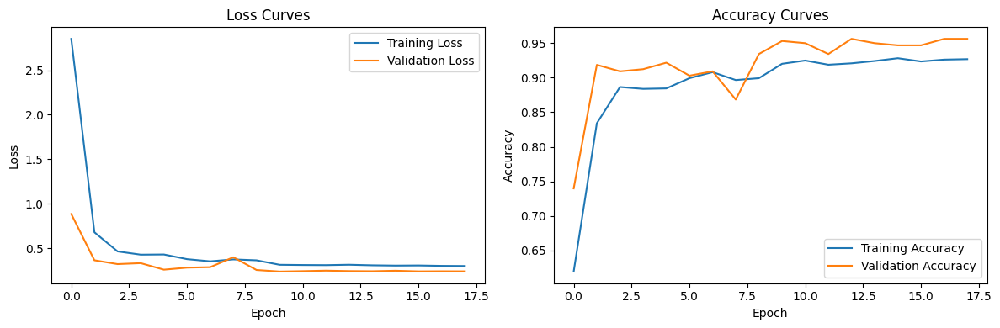

In [ ]:
# get best hyper parameters
best_hp = tuner.get_best_hyperparameters(num_trials=1)[0]

# use best hyper parameters to rebuild model
best_model = build_model_label_encoding(best_hp)

# use best model to retrain on training set and save training history
history = best_model.fit(X_train_nn_umap, y_train_nn_encoded,
                         epochs=50,
                         batch_size=64,
                         validation_data=(X_val_nn_umap, y_val_nn_encoded),
                         callbacks=[early_stop, reduce_lr, tensorboard_callback])

# plot loss curves for training and validation set
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss Curves')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

# plot accuracy curves for training and validation
plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy Curves')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.tight_layout()
plt.show()

In [ ]:
best_model.save(model_path)

In [ ]:
restored_model = load_model(model_path)

In [ ]:
%tensorboard --logdir '/content/drive/My Drive/Colab Notebooks/tuner_results_labenc/bbc_text_classification/logs'

<IPython.core.display.Javascript object>

# One-Hot Encoding

In [ ]:
# One-Hot Encoding on the categories of the training set, validation set, and test set
onehot_encoder_nn = OneHotEncoder()
y_train_nn_onehot = onehot_encoder_nn.fit_transform(y_train_nn.values.reshape(-1, 1)).toarray()
y_val_nn_onehot = onehot_encoder_nn.transform(y_val_nn.values.reshape(-1, 1)).toarray()
y_test_nn_onehot = onehot_encoder_nn.transform(y_test_nn.values.reshape(-1, 1)).toarray()

print(type(X_train_nn_embeddings), X_train_nn_embeddings.shape)
print(type(y_train_nn_onehot), y_train_nn_onehot.shape)

# category labels
print("One-Hot Encoded labels:")
print(onehot_encoder_nn.categories_)

<class 'numpy.ndarray'> (1488, 768)
<class 'numpy.ndarray'> (1488, 5)
One-Hot Encoded labels:
[array(['business', 'entertainment', 'politics', 'sport', 'tech'],
      dtype=object)]


# One-Hot Encoding Sequential Model: Random Search, SGD, RMSprop, Adam, Adamax, Nadam

In [ ]:
# calculate the number of classes from y_train_nn_onehot
num_classes = y_train_nn_onehot.shape[1]

# setup for using the custom model building function from Code 71
def build_model_onehot_encoding(hp):
    model = Sequential()

    # search the size of the hidden layer
    dense_layer_sizes = hp.Int('dense_layer_sizes', min_value=64, max_value=1024, step=64)

    # search activation function
    activation_choice = hp.Choice('activation', values=['relu', 'elu', 'selu', 'leaky_relu'])

    # defining the first layer of a Sequential model
    # dense_layer_sizes: number of neurons in the layer
    # activation function choice in search
    # He normal(pre-defined) initializer used to initialize weights based on
      # a Gaussian distribution where the standard deviation is calculated as sqrt(2/number_of_inputs)
    # 'input_shape=' sets up the first layer of the network to correctly handle the input data based on its feature size
      # to facilitate the forward propagation of data through the network for training
    model.add(Dense(dense_layer_sizes, activation=activation_choice, kernel_initializer='he_normal', input_shape=(X_train_nn_embeddings.shape[1],)))

    # search dropout rate
    # hp.Choice: use Keras Tuner hyperparameter tuning will try different launch functions specified in the activation_choice
    # test different dropout rates between 0.0 and 0.5, in increments of 0.1
    dropout_rate = hp.Float('dropout_rate', min_value=0.0, max_value=0.5, step=0.1)

    # adds a Dropout layer to the neural network model
    model.add(Dropout(dropout_rate))

    # # add an additional hidden layer
    model.add(Dense(512, activation=activation_choice, kernel_initializer='he_normal'))

    # another dropout layer to help prevent overfitting
    model.add(Dropout(dropout_rate))

    # use softmax activation function for multi-class classification
      # and output a probability distribution over the 5 classes
    model.add(Dense(num_classes, activation="softmax"))

    # 'sgd': Stochastic Gradient Descent, a basic but effective approach, optionally employing momentum
    # 'rmsprop': use the magnitude of recent gradients to normalize the gradients
    # 'adam': Adaptive Moment Estimation combines the advantages of AdaGrad and RMSProp
    # 'adamax': variant of Adam based on the infinity norm
    # 'nadam': Nesterov-accelerated Adaptive Moment Estimation, combining Nesterov momentum and Adam
    optimizer_choice = hp.Choice('optimizer', values=['sgd', 'rmsprop', 'adam', 'adamax', 'nadam'])
    learning_rate = hp.Float('learning_rate', min_value=1e-4, max_value=1e-2, sampling='LOG')
    momentum = hp.Float('momentum', min_value=0.0, max_value=1.0, default=0.9, step=0.1)
    # rho: used in RMSprop, controls the decay rate of the moving average of squared gradients
    rho = hp.Float('rho', min_value=0.0, max_value=1.0, default=0.9, step=0.1)
    # beta_1 and beta_2: Used in Adam and Nadam.
      # beta_1 controls the exponential decay rate for the moving average of past gradients
      # beta_2 controls the exponential decay rate for the moving average of past squared gradients
    beta_1 = hp.Float('beta_1', min_value=0.0, max_value=1.0, default=0.9, step=0.1)
    beta_2 = hp.Float('beta_2', min_value=0.0, max_value=1.0, default=0.999, step=0.001)
    # nesterov: boolean flag to enable Nesterov momentum helps improve convergence rates in some cases
    nesterov = hp.Boolean('nesterov', default=True)

    if optimizer_choice == 'sgd':
        optimizer = SGD(learning_rate=learning_rate, momentum=momentum, nesterov=nesterov)
    elif optimizer_choice == 'rmsprop':
        optimizer = RMSprop(learning_rate=learning_rate, rho=rho)
    elif optimizer_choice == 'adam':
        optimizer = Adam(learning_rate=learning_rate, beta_1=beta_1, beta_2=beta_2)
    elif optimizer_choice == 'adamax':
        optimizer = Adamax(learning_rate=learning_rate, beta_1=beta_1, beta_2=beta_2)
    elif optimizer_choice == 'nadam':
        optimizer = Nadam(learning_rate=learning_rate, beta_1=beta_1, beta_2=beta_2)

    # loss='categorical_crossentropy' and metrics= 'accuracy' are both for classification task
    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
    return model

In [ ]:
# define callback functions for early stopping and learning rate adjustment
early_stop = EarlyStopping(monitor='val_accuracy', patience=5, mode='max', restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_accuracy', factor=0.1, patience=3, mode='max')

# create a log directory for TensorBoard
log_dir = os.path.join('/content/drive/My Drive/Colab Notebooks', 'tuner_results_onehot_Random', 'bbc_text_classification', 'logs')
tensorboard_callback = TensorBoard(log_dir=log_dir, histogram_freq=1)

# ensure the path exists
os.makedirs(log_dir, exist_ok=True)

# define the model saving path
model_path = os.path.join(log_dir, 'best_model.keras')

# setup Keras Tuner
tuner = kt.RandomSearch(
    build_model_onehot_encoding,
    objective='val_accuracy',
    max_trials=30,
    executions_per_trial=1,
    directory='tuner_results_onehot_Random',
    project_name='bbc_text_classification',
    overwrite=True
)

# search for the best model configuration
tuner.search(
    X_train_nn_embeddings, y_train_nn_onehot,
    epochs=50,
    validation_data=(X_val_nn_embeddings, y_val_nn_onehot),
    callbacks=[early_stop, reduce_lr, tensorboard_callback],
    verbose=2
)

# get the best model
best_model = tuner.get_best_models(num_models=1)[0]

Trial 30 Complete [00h 00m 07s]
val_accuracy: 0.9874607920646667

Best val_accuracy So Far: 0.9905956387519836
Total elapsed time: 00h 03m 53s


In [ ]:
!ls tuner_results_onehot_Random/bbc_text_classification

logs	     trial_02  trial_06  trial_10  trial_14  trial_18  trial_22  trial_26  tuner0.json
oracle.json  trial_03  trial_07  trial_11  trial_15  trial_19  trial_23  trial_27
trial_00     trial_04  trial_08  trial_12  trial_16  trial_20  trial_24  trial_28
trial_01     trial_05  trial_09  trial_13  trial_17  trial_21  trial_25  trial_29


In [ ]:
best_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 448)               344512    
                                                                 
 dropout (Dropout)           (None, 448)               0         
                                                                 
 dense_1 (Dense)             (None, 512)               229888    
                                                                 
 dropout_1 (Dropout)         (None, 512)               0         
                                                                 
 dense_2 (Dense)             (None, 5)                 2565      
                                                                 
Total params: 576965 (2.20 MB)
Trainable params: 576965 (2.20 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
best_hp = tuner.get_best_hyperparameters(num_trials=1)[0]
print(best_hp.values)

{'dense_layer_sizes': 448, 'activation': 'relu', 'dropout_rate': 0.2, 'optimizer': 'rmsprop', 'learning_rate': 0.001300398010371077, 'momentum': 0.30000000000000004, 'rho': 0.5, 'beta_1': 0.30000000000000004, 'beta_2': 0.152, 'nesterov': True}


In [ ]:
tuner.results_summary()

Results summary
Results in tuner_results_onehot_Random/bbc_text_classification
Showing 10 best trials
Objective(name="val_accuracy", direction="max")

Trial 03 summary
Hyperparameters:
dense_layer_sizes: 448
activation: relu
dropout_rate: 0.2
optimizer: rmsprop
learning_rate: 0.001300398010371077
momentum: 0.30000000000000004
rho: 0.5
beta_1: 0.30000000000000004
beta_2: 0.152
nesterov: True
Score: 0.9905956387519836

Trial 05 summary
Hyperparameters:
dense_layer_sizes: 768
activation: elu
dropout_rate: 0.1
optimizer: nadam
learning_rate: 0.0011418581028573094
momentum: 0.7000000000000001
rho: 0.8
beta_1: 0.2
beta_2: 0.682
nesterov: False
Score: 0.9905956387519836

Trial 10 summary
Hyperparameters:
dense_layer_sizes: 832
activation: elu
dropout_rate: 0.4
optimizer: nadam
learning_rate: 0.0006620419808746878
momentum: 0.30000000000000004
rho: 0.0
beta_1: 0.6000000000000001
beta_2: 0.724
nesterov: False
Score: 0.9905956387519836

Trial 21 summary
Hyperparameters:
dense_layer_sizes: 960
ac

Epoch 1/50
24/24 [==============================] - 1s 18ms/step - loss: 0.9021 - accuracy: 0.6458 - val_loss: 0.2172 - val_accuracy: 0.9342 - lr: 0.0013
Epoch 2/50
24/24 [==============================] - 0s 8ms/step - loss: 0.3116 - accuracy: 0.8931 - val_loss: 0.2151 - val_accuracy: 0.9091 - lr: 0.0013
Epoch 3/50
24/24 [==============================] - 0s 8ms/step - loss: 0.2016 - accuracy: 0.9281 - val_loss: 0.1516 - val_accuracy: 0.9530 - lr: 0.0013
Epoch 4/50
24/24 [==============================] - 0s 8ms/step - loss: 0.1315 - accuracy: 0.9563 - val_loss: 0.2060 - val_accuracy: 0.9248 - lr: 0.0013
Epoch 5/50
24/24 [==============================] - 0s 8ms/step - loss: 0.1341 - accuracy: 0.9523 - val_loss: 0.5752 - val_accuracy: 0.8495 - lr: 0.0013
Epoch 6/50
24/24 [==============================] - 0s 8ms/step - loss: 0.1326 - accuracy: 0.9556 - val_loss: 0.2866 - val_accuracy: 0.9248 - lr: 0.0013
Epoch 7/50
24/24 [==============================] - 0s 8ms/step - loss: 0.0670 - 

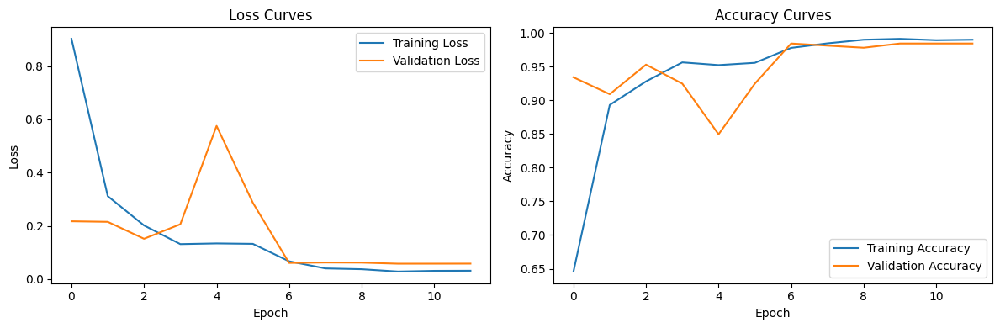

In [ ]:
# get the hyperparameters of the best model
best_hp = tuner.get_best_hyperparameters(num_trials=1)[0]

# rebuild the model using optimal hyperparameters
best_model = build_model_onehot_encoding(best_hp)

# use the best model to retrain on the training set and save the training history
history = best_model.fit(X_train_nn_embeddings, y_train_nn_onehot,
                         epochs=50,
                         batch_size=64,
                         validation_data=(X_val_nn_embeddings, y_val_nn_onehot),
                         callbacks=[early_stop, reduce_lr, tensorboard_callback])

# plot loss curves for training and validation
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss Curves')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

# plot accuracy curves for training and validation
plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy Curves')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.tight_layout()
plt.show()

In [ ]:
best_model.save(model_path)

In [ ]:
restored_model = load_model(model_path)

In [ ]:
%tensorboard --logdir '/content/drive/My Drive/Colab Notebooks/tuner_results_onehot_Random/bbc_text_classification/logs'

# One-Hot Encoding Sequential Model: Hyperband optimisation, SGD, RMSprop, Adam, Adamax, Nadam

In [ ]:
# Calculate the number of classes from y_train_nn_onehot
num_classes = y_train_nn_onehot.shape[1]

def build_model_hyperband(hp):
    model = Sequential()
    dense_layer_sizes = hp.Choice('dense_layer_sizes', values=[64, 128, 256, 512, 1024])
    activation_choice = hp.Choice('activation', values=['relu', 'elu', 'selu', 'leaky_relu'])

    model.add(Dense(dense_layer_sizes, activation=activation_choice, kernel_initializer='he_normal', input_shape=(X_train_nn_embeddings.shape[1],)))
    dropout_rate = hp.Float('dropout_rate', min_value=0.0, max_value=0.5, step=0.1)
    model.add(Dropout(dropout_rate))
    model.add(Dense(512, activation=activation_choice, kernel_initializer='he_normal'))
    model.add(Dropout(dropout_rate))
    model.add(Dense(num_classes, activation="softmax"))

    optimizer_choice = hp.Choice('optimizer', values=['sgd', 'rmsprop', 'adam', 'adamax', 'nadam'])
    learning_rate = hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])

    if optimizer_choice == 'sgd':
        optimizer = SGD(learning_rate=learning_rate)
    elif optimizer_choice == 'rmsprop':
        optimizer = RMSprop(learning_rate=learning_rate)
    elif optimizer_choice == 'adam':
        optimizer = Adam(learning_rate=learning_rate)
    elif optimizer_choice == 'adamax':
        optimizer = Adamax(learning_rate=learning_rate)
    elif optimizer_choice == 'nadam':
        optimizer = Nadam(learning_rate=learning_rate)

    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
    return model

In [ ]:
# define callback functions for early stopping and learning rate adjustment
early_stop = EarlyStopping(monitor='val_accuracy', patience=5, mode='max', restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_accuracy', factor=0.1, patience=3, mode='max')

# create a log directory for TensorBoard
log_dir = os.path.join('/content/drive/My Drive/Colab Notebooks', 'tuner_results_onehot_Hyperband', 'bbc_text_classification', 'logs')
tensorboard_callback = TensorBoard(log_dir=log_dir, histogram_freq=1)

# ensure the path exists
os.makedirs(log_dir, exist_ok=True)

# define the model saving path
model_path = os.path.join(log_dir, 'best_model.keras')

# define Hyperband tuner
tuner = Hyperband(
    build_model_hyperband,
    objective='val_accuracy',
    max_epochs=27,
    factor=3,
    directory='tuner_results_onehot_Hyperband',
    project_name='bbc_text_classification',
    overwrite=True
)

# search for the best model configuration
tuner.search(
    X_train_nn_embeddings, y_train_nn_onehot,
    epochs=50,
    validation_data=(X_val_nn_embeddings, y_val_nn_onehot),
    callbacks=[early_stop, reduce_lr, tensorboard_callback],
    verbose=2
)

# get the best model
best_model = tuner.get_best_models(num_models=1)[0]

Trial 70 Complete [00h 00m 07s]
val_accuracy: 0.9905956387519836

Best val_accuracy So Far: 0.9905956387519836
Total elapsed time: 00h 04m 03s


In [ ]:
!ls tuner_results_onehot_Hyperband/bbc_text_classification

logs	     trial_0008  trial_0018  trial_0028  trial_0038  trial_0048  trial_0058  trial_0068
oracle.json  trial_0009  trial_0019  trial_0029  trial_0039  trial_0049  trial_0059  trial_0069
trial_0000   trial_0010  trial_0020  trial_0030  trial_0040  trial_0050  trial_0060  tuner0.json
trial_0001   trial_0011  trial_0021  trial_0031  trial_0041  trial_0051  trial_0061
trial_0002   trial_0012  trial_0022  trial_0032  trial_0042  trial_0052  trial_0062
trial_0003   trial_0013  trial_0023  trial_0033  trial_0043  trial_0053  trial_0063
trial_0004   trial_0014  trial_0024  trial_0034  trial_0044  trial_0054  trial_0064
trial_0005   trial_0015  trial_0025  trial_0035  trial_0045  trial_0055  trial_0065
trial_0006   trial_0016  trial_0026  trial_0036  trial_0046  trial_0056  trial_0066
trial_0007   trial_0017  trial_0027  trial_0037  trial_0047  trial_0057  trial_0067


In [ ]:
best_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 64)                49216     
                                                                 
 dropout (Dropout)           (None, 64)                0         
                                                                 
 dense_1 (Dense)             (None, 512)               33280     
                                                                 
 dropout_1 (Dropout)         (None, 512)               0         
                                                                 
 dense_2 (Dense)             (None, 5)                 2565      
                                                                 
Total params: 85061 (332.27 KB)
Trainable params: 85061 (332.27 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
best_hp = tuner.get_best_hyperparameters(num_trials=1)[0]
print(best_hp.values)

{'dense_layer_sizes': 64, 'activation': 'relu', 'dropout_rate': 0.0, 'optimizer': 'nadam', 'learning_rate': 0.01, 'tuner/epochs': 9, 'tuner/initial_epoch': 3, 'tuner/bracket': 2, 'tuner/round': 1, 'tuner/trial_id': '0051'}


In [ ]:
tuner.results_summary()

Results summary
Results in tuner_results_onehot_Hyperband/bbc_text_classification
Showing 10 best trials
Objective(name="val_accuracy", direction="max")

Trial 0054 summary
Hyperparameters:
dense_layer_sizes: 64
activation: relu
dropout_rate: 0.0
optimizer: nadam
learning_rate: 0.01
tuner/epochs: 9
tuner/initial_epoch: 3
tuner/bracket: 2
tuner/round: 1
tuner/trial_id: 0051
Score: 0.9905956387519836

Trial 0057 summary
Hyperparameters:
dense_layer_sizes: 256
activation: elu
dropout_rate: 0.2
optimizer: adam
learning_rate: 0.001
tuner/epochs: 27
tuner/initial_epoch: 9
tuner/bracket: 2
tuner/round: 2
tuner/trial_id: 0053
Score: 0.9905956387519836

Trial 0066 summary
Hyperparameters:
dense_layer_sizes: 1024
activation: relu
dropout_rate: 0.30000000000000004
optimizer: nadam
learning_rate: 0.01
tuner/epochs: 27
tuner/initial_epoch: 0
tuner/bracket: 0
tuner/round: 0
Score: 0.9905956387519836

Trial 0069 summary
Hyperparameters:
dense_layer_sizes: 256
activation: selu
dropout_rate: 0.4
optimi

Epoch 1/50


24/24 [==============================] - 2s 17ms/step - loss: 0.8396 - accuracy: 0.7030 - val_loss: 0.1134 - val_accuracy: 0.9687 - lr: 0.0100
Epoch 2/50
24/24 [==============================] - 0s 7ms/step - loss: 0.1253 - accuracy: 0.9603 - val_loss: 0.1215 - val_accuracy: 0.9624 - lr: 0.0100
Epoch 3/50
24/24 [==============================] - 0s 7ms/step - loss: 0.0780 - accuracy: 0.9758 - val_loss: 0.1743 - val_accuracy: 0.9310 - lr: 0.0100
Epoch 4/50
24/24 [==============================] - 0s 7ms/step - loss: 0.0711 - accuracy: 0.9765 - val_loss: 0.0779 - val_accuracy: 0.9812 - lr: 0.0100
Epoch 5/50
24/24 [==============================] - 0s 7ms/step - loss: 0.0329 - accuracy: 0.9872 - val_loss: 0.2150 - val_accuracy: 0.9342 - lr: 0.0100
Epoch 6/50
24/24 [==============================] - 0s 7ms/step - loss: 0.0287 - accuracy: 0.9913 - val_loss: 0.1395 - val_accuracy: 0.9624 - lr: 0.0100
Epoch 7/50
24/24 [==============================] - 0s 7ms/step - loss: 0.0281 - accuracy: 0

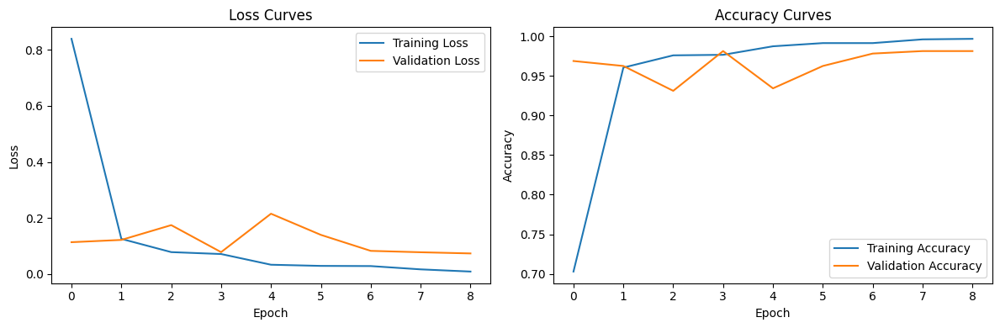

In [ ]:
# get the hyperparameters of the best model
best_hp = tuner.get_best_hyperparameters(num_trials=1)[0]

# rebuild the model using optimal hyperparameters
best_model = build_model_onehot_encoding(best_hp)

# use the best model to retrain on the training set and save the training history
history = best_model.fit(X_train_nn_embeddings, y_train_nn_onehot,
                         epochs=50,
                         batch_size=64,
                         validation_data=(X_val_nn_embeddings, y_val_nn_onehot),
                         callbacks=[early_stop, reduce_lr, tensorboard_callback])

# plot loss curves for training and validation
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss Curves')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

# plot accuracy curves for training and validation
plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy Curves')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.tight_layout()
plt.show()

In [ ]:
best_model.save(model_path)

In [ ]:
restored_model = load_model(model_path)

In [ ]:
%tensorboard --logdir '/content/drive/My Drive/Colab Notebooks/tuner_results_onehot_Hyperband/bbc_text_classification/logs'

<IPython.core.display.Javascript object>

# One-Hot Encoding Sequential Model: Bayesian optimisation, SGD, RMSprop, Adam, Adamax, Nadam

In [ ]:
# calculate the number of classes from y_train_nn_onehot
num_classes = y_train_nn_onehot.shape[1]

def build_model_bayesian(hp):
    model = Sequential()
    dense_layer_sizes = hp.Choice('dense_layer_sizes', values=[64, 128, 256, 512, 1024])
    activation_choice = hp.Choice('activation', values=['relu', 'elu', 'selu', 'leaky_relu'])

    model.add(Dense(dense_layer_sizes, activation=activation_choice, kernel_initializer='he_normal', input_shape=(X_train_nn_embeddings.shape[1],)))
    dropout_rate = hp.Float('dropout_rate', min_value=0.0, max_value=0.5, step=0.1)
    model.add(Dropout(dropout_rate))

    model.add(Dense(512, activation=activation_choice, kernel_initializer='he_normal'))
    model.add(Dropout(dropout_rate))

    model.add(Dense(num_classes, activation="softmax"))

    optimizer_choice = hp.Choice('optimizer', values=['sgd', 'rmsprop', 'adam', 'adamax', 'nadam'])
    learning_rate = hp.Float('learning_rate', min_value=1e-4, max_value=1e-2, sampling='LOG')

    if optimizer_choice == 'sgd':
        optimizer = SGD(learning_rate=learning_rate)
    elif optimizer_choice == 'rmsprop':
        optimizer = RMSprop(learning_rate=learning_rate)
    elif optimizer_choice == 'adam':
        optimizer = Adam(learning_rate=learning_rate)
    elif optimizer_choice == 'adamax':
        optimizer = Adamax(learning_rate=learning_rate)
    elif optimizer_choice == 'nadam':
        optimizer = Nadam(learning_rate=learning_rate)

    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
    return model

In [ ]:
# define callback functions for early stopping and learning rate adjustment
early_stop = EarlyStopping(monitor='val_accuracy', patience=5, mode='max', restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_accuracy', factor=0.1, patience=3, mode='max')

# create a log directory for TensorBoard
log_dir = os.path.join('/content/drive/My Drive/Colab Notebooks', 'tuner_results_onehot_Bayesian', 'bbc_text_classification', 'logs')
tensorboard_callback = TensorBoard(log_dir=log_dir, histogram_freq=1)

# ensure the path exists
os.makedirs(log_dir, exist_ok=True)

# define the model saving path
model_path = os.path.join(log_dir, 'best_model.keras')

# define Bayesian Optimization tuner
tuner = BayesianOptimization(
    build_model_bayesian,
    objective='val_accuracy',
    max_trials=30,  # total number of trials to test different configurations
    num_initial_points=10,  # number of random configurations to start the optimization
    directory='tuner_results_onehot_Bayesian',
    project_name='bbc_text_classification',
    overwrite=True
)

# search for the best model configuration
tuner.search(
    X_train_nn_embeddings, y_train_nn_onehot,
    epochs=50,
    validation_data=(X_val_nn_embeddings, y_val_nn_onehot),
    callbacks=[early_stop, reduce_lr, tensorboard_callback],
    verbose=2
)

# Get the best model
best_model = tuner.get_best_models(num_models=1)[0]

Trial 30 Complete [00h 00m 06s]
val_accuracy: 0.9811912178993225

Best val_accuracy So Far: 0.9905956387519836
Total elapsed time: 00h 04m 13s


In [ ]:
!ls tuner_results_onehot_Bayesian/bbc_text_classification

logs	     trial_02  trial_06  trial_10  trial_14  trial_18  trial_22  trial_26  tuner0.json
oracle.json  trial_03  trial_07  trial_11  trial_15  trial_19  trial_23  trial_27
trial_00     trial_04  trial_08  trial_12  trial_16  trial_20  trial_24  trial_28
trial_01     trial_05  trial_09  trial_13  trial_17  trial_21  trial_25  trial_29


In [ ]:
best_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 1024)              787456    
                                                                 
 dropout (Dropout)           (None, 1024)              0         
                                                                 
 dense_1 (Dense)             (None, 512)               524800    
                                                                 
 dropout_1 (Dropout)         (None, 512)               0         
                                                                 
 dense_2 (Dense)             (None, 5)                 2565      
                                                                 
Total params: 1314821 (5.02 MB)
Trainable params: 1314821 (5.02 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
best_hp = tuner.get_best_hyperparameters(num_trials=1)[0]
print(best_hp.values)

{'dense_layer_sizes': 1024, 'activation': 'relu', 'dropout_rate': 0.2, 'optimizer': 'adam', 'learning_rate': 0.0007443190353728441}


In [ ]:
tuner.results_summary()

Results summary
Results in tuner_results_onehot_Bayesian/bbc_text_classification
Showing 10 best trials
Objective(name="val_accuracy", direction="max")

Trial 06 summary
Hyperparameters:
dense_layer_sizes: 1024
activation: relu
dropout_rate: 0.2
optimizer: adam
learning_rate: 0.0007443190353728441
Score: 0.9905956387519836

Trial 13 summary
Hyperparameters:
dense_layer_sizes: 1024
activation: elu
dropout_rate: 0.2
optimizer: nadam
learning_rate: 0.005887649478014836
Score: 0.9905956387519836

Trial 01 summary
Hyperparameters:
dense_layer_sizes: 512
activation: selu
dropout_rate: 0.30000000000000004
optimizer: adam
learning_rate: 0.0005034672825968825
Score: 0.9874607920646667

Trial 15 summary
Hyperparameters:
dense_layer_sizes: 256
activation: leaky_relu
dropout_rate: 0.4
optimizer: nadam
learning_rate: 0.007259129682380179
Score: 0.9874607920646667

Trial 16 summary
Hyperparameters:
dense_layer_sizes: 1024
activation: leaky_relu
dropout_rate: 0.0
optimizer: nadam
learning_rate: 0.002

Epoch 1/50
24/24 [==============================] - 2s 20ms/step - loss: 0.7022 - accuracy: 0.7621 - val_loss: 0.1615 - val_accuracy: 0.9498 - lr: 7.4432e-04
Epoch 2/50
24/24 [==============================] - 0s 10ms/step - loss: 0.1667 - accuracy: 0.9483 - val_loss: 0.1194 - val_accuracy: 0.9655 - lr: 7.4432e-04
Epoch 3/50
24/24 [==============================] - 0s 9ms/step - loss: 0.1094 - accuracy: 0.9617 - val_loss: 0.0830 - val_accuracy: 0.9749 - lr: 7.4432e-04
Epoch 4/50
24/24 [==============================] - 0s 9ms/step - loss: 0.0783 - accuracy: 0.9724 - val_loss: 0.0765 - val_accuracy: 0.9749 - lr: 7.4432e-04
Epoch 5/50
24/24 [==============================] - 0s 9ms/step - loss: 0.0668 - accuracy: 0.9819 - val_loss: 0.0740 - val_accuracy: 0.9781 - lr: 7.4432e-04
Epoch 6/50
24/24 [==============================] - 0s 9ms/step - loss: 0.0763 - accuracy: 0.9691 - val_loss: 0.1312 - val_accuracy: 0.9530 - lr: 7.4432e-04
Epoch 7/50
24/24 [==============================] - 0s 9

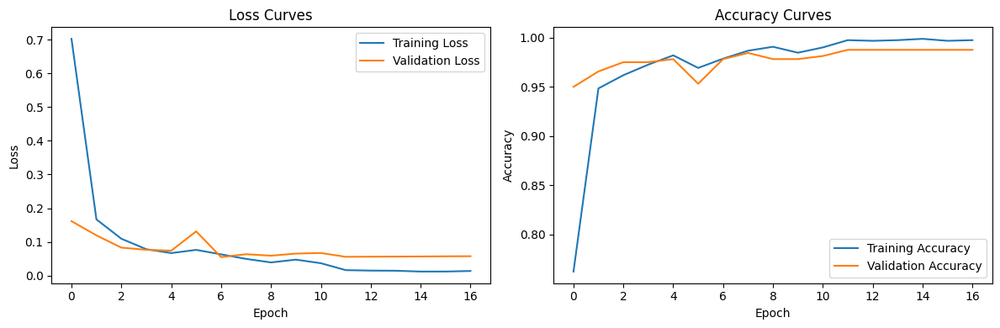

In [ ]:
# get the hyperparameters of the best model
best_hp = tuner.get_best_hyperparameters(num_trials=1)[0]

# rebuild the model using optimal hyperparameters
best_model = build_model_onehot_encoding(best_hp)

# use the best model to retrain on the training set and save the training history
history = best_model.fit(X_train_nn_embeddings, y_train_nn_onehot,
                         epochs=50,
                         batch_size=64,
                         validation_data=(X_val_nn_embeddings, y_val_nn_onehot),
                         callbacks=[early_stop, reduce_lr, tensorboard_callback])

# plot loss curves for training and validation
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss Curves')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

# plot accuracy curves for training and validation
plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy Curves')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.tight_layout()
plt.show()

In [ ]:
best_model.save(model_path)

In [ ]:
restored_model = load_model(model_path)

In [ ]:
%tensorboard --logdir '/content/drive/My Drive/Colab Notebooks/tuner_results_onehot_Bayesian/bbc_text_classification/logs'

# Evaluate on Test Set

In [ ]:
# predict the classes using the best model on the test set
test_predictions = best_model.predict(X_test_nn_embeddings)
test_predictions_classes = np.argmax(test_predictions, axis=1)

10/10 [==============================] - 0s 2ms/step


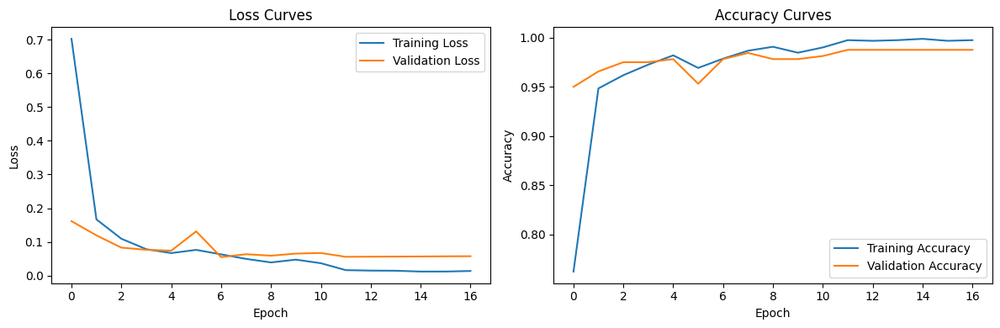

In [ ]:
# plot Training and Validation Loss and Accuracy Curves
plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss Curves')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy Curves')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.tight_layout()
plt.show()

In [ ]:
# evaluate the Model's Performance on the Test Set
test_loss, test_accuracy = best_model.evaluate(X_test_nn_embeddings, y_test_nn_onehot)
print(f"Test Loss: {test_loss}")
print(f"Test Accuracy: {test_accuracy}")

10/10 [==============================] - 0s 2ms/step - loss: 0.0716 - accuracy: 0.9718
Test Loss: 0.0716082900762558
Test Accuracy: 0.9717868566513062


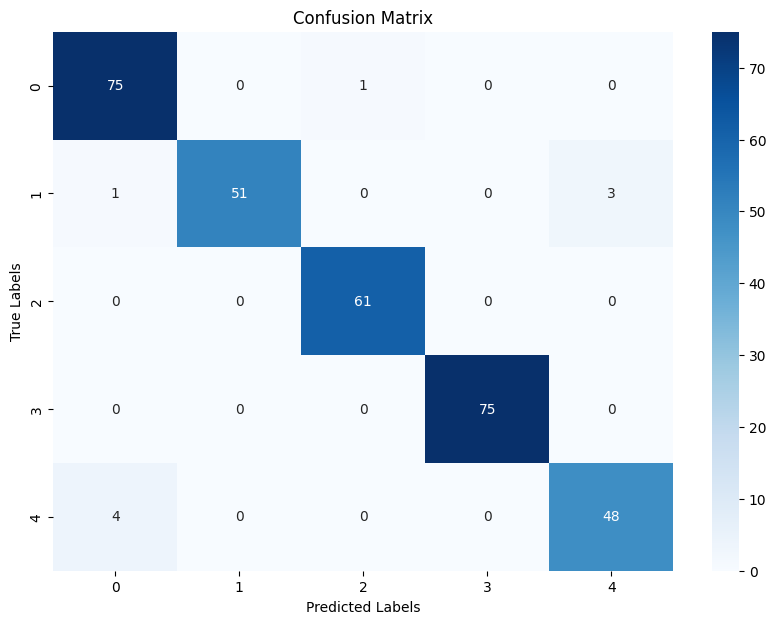

In [ ]:
# plot Confusion Matrix

# get true classes for the test set
true_classes = np.argmax(y_test_nn_onehot, axis=1)

# compute the confusion matrix
cm = confusion_matrix(true_classes, test_predictions_classes)

# plot the confusion matrix
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix')
plt.ylabel('True Labels')
plt.xlabel('Predicted Labels')
plt.show()